<a href="https://colab.research.google.com/github/yaseminsekmen/XRayLungProcessing/blob/main/XRayLungProcessing%20.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
# Kütüphanelerin içe aktarılması
import pandas as pd  # Veri işleme
import numpy as np  # Sayısal işlemler
import cv2  # OpenCV - Görüntü işleme
from skimage import io  # Skimage görselleştirme ve işleme
import matplotlib.pyplot as plt  # Görselleştirme için
import seaborn as sns  # Gelişmiş görselleştirme
import os  # Dosya yolu işlemleri

# Seaborn ve matplotlib varsayılan ayarlarını optimize etme
sns.set_theme(style="darkgrid")
plt.rcParams['figure.figsize'] = (10, 6)

# Örnek dosya yolu belirtme
data_path = os.path.join("path", "to", "your", "data")  # Verinizin bulunduğu klasörün yolunu belirtin

print("Gerekli kütüphaneler başarıyla yüklendi ve dosya yolu ayarlandı.")

Gerekli kütüphaneler başarıyla yüklendi ve dosya yolu ayarlandı.


In [2]:
!git clone https://github.com/hardik0/AI-for-Medicine-Specialization
%cd AI-for-Medicine-Specialization/AI-for-Medical-Diagnosis/

Cloning into 'AI-for-Medicine-Specialization'...
remote: Enumerating objects: 1601, done.
remote: Counting objects: 100% (28/28), done.
remote: Compressing objects: 100% (28/28), done.
remote: Total 1601 (delta 9), reused 2 (delta 0), pack-reused 1573 (from 1)
Receiving objects: 100% (1601/1601), 720.36 MiB | 28.07 MiB/s, done.
Resolving deltas: 100% (30/30), done.
Updating files: 100% (1497/1497), done.
/content/AI-for-Medicine-Specialization/AI-for-Medical-Diagnosis


In [3]:
# İndirilen klasör içeriğini listeleyelim
%ls nih/

densenet.hdf5  images_small/  pretrained_model.h5  test.csv  train-small.csv  valid-small.csv


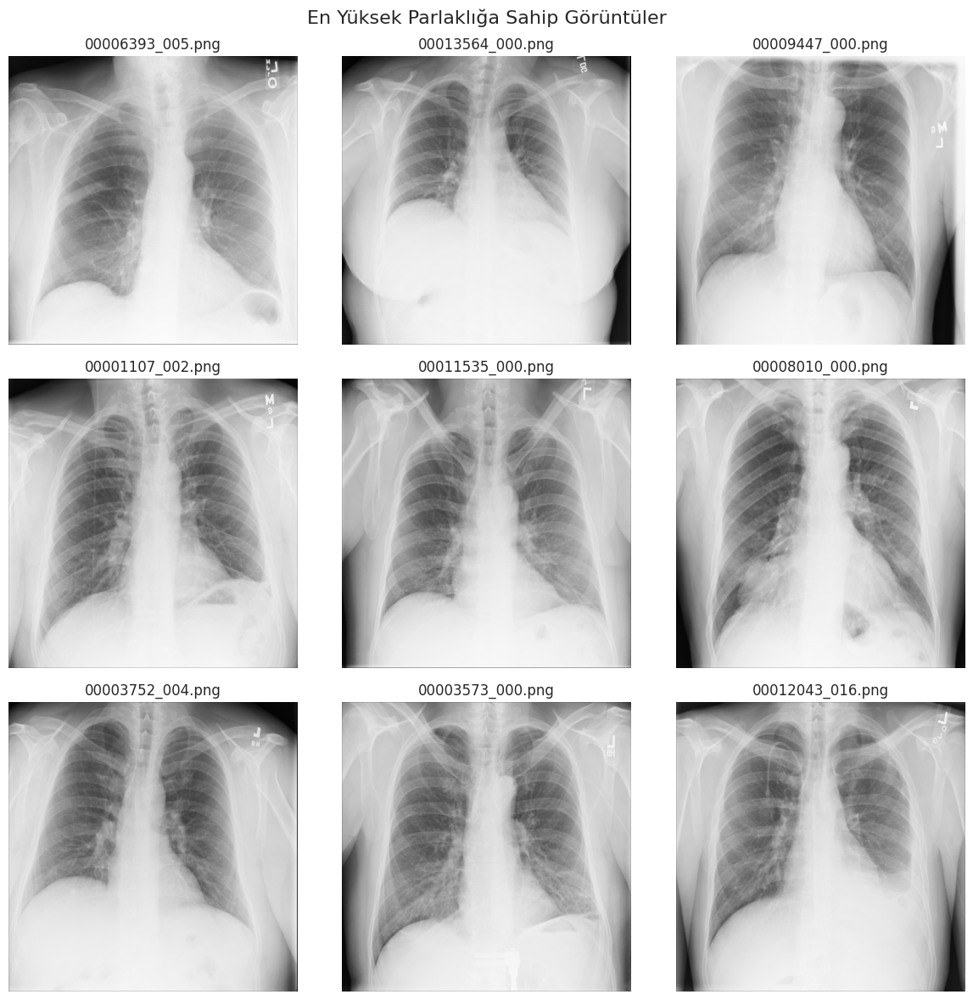

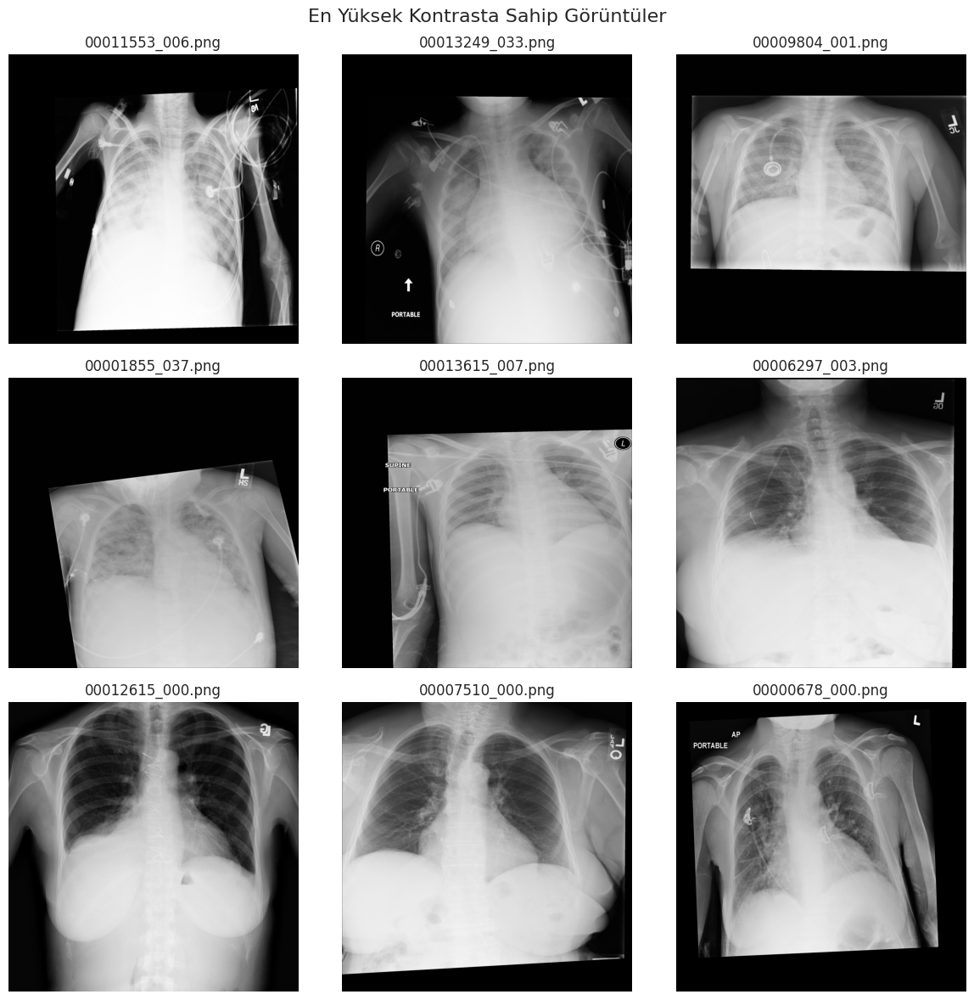

In [4]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Görüntülerin bulunduğu klasör
data_path = "nih/images_small"

# Görüntü dosyalarını listeleme
image_files = [f for f in os.listdir(data_path) if f.endswith(('.jpg', '.png'))]

# Parlaklık Hesaplama Fonksiyonu
def calculate_brightness(image):
    """
    Görüntünün parlaklığını hesaplar.
    :param image: Orijinal görüntü (RGB formatında)
    :return: Parlaklık değeri (ortalama yoğunluk)
    """
    gray_image = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)  # Gri tonlamaya çevir
    return np.mean(gray_image)

# Kontrast Hesaplama Fonksiyonu
def calculate_contrast(image):
    """
    Görüntünün kontrastını hesaplar.
    :param image: Orijinal görüntü (RGB formatında)
    :return: Kontrast değeri (standart sapma)
    """
    gray_image = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)  # Gri tonlamaya çevir
    return np.std(gray_image)

# Parlaklık ve Kontrast Skorlarını Hesaplama
brightness_scores = []
contrast_scores = []

for image_file in image_files:
    image_path = os.path.join(data_path, image_file)
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # BGR'den RGB'ye çevir

    # Parlaklık ve kontrast hesapla
    brightness = calculate_brightness(image)
    contrast = calculate_contrast(image)

    brightness_scores.append((image_file, brightness))
    contrast_scores.append((image_file, contrast))

# Parlaklık ve kontrast skorlarına göre sıralama
sorted_brightness = sorted(brightness_scores, key=lambda x: x[1], reverse=True)
sorted_contrast = sorted(contrast_scores, key=lambda x: x[1], reverse=True)

# En yüksek parlaklığa sahip 9 görüntü
top_brightness_images = [x[0] for x in sorted_brightness[:9]]

# En yüksek kontrasta sahip 9 görüntü
top_contrast_images = [x[0] for x in sorted_contrast[:9]]

# Seçilen görüntüleri görselleştirme
def visualize_images(selected_images, title):
    """
    Seçilen görüntüleri görselleştirir.
    :param selected_images: Görüntü dosya adları
    :param title: Görselleştirme başlığı
    """
    fig, axes = plt.subplots(3, 3, figsize=(12, 12))
    for i, ax in enumerate(axes.flat):
        image_path = os.path.join(data_path, selected_images[i])
        image = cv2.imread(image_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        ax.imshow(image)
        ax.set_title(selected_images[i])
        ax.axis('off')
    plt.suptitle(title, fontsize=16)
    plt.tight_layout()
    plt.show()

# Parlaklığa göre seçilen görüntüleri görselleştir
visualize_images(top_brightness_images, "En Yüksek Parlaklığa Sahip Görüntüler")

# Kontrasta göre seçilen görüntüleri görselleştir
visualize_images(top_contrast_images, "En Yüksek Kontrasta Sahip Görüntüler")


Parlaklığı yüksek olan görüntüler genellikle daha fazla ayrıntıyı görmeye olanak tanır ve akciğer gibi önemli bölgelerin daha belirgin hale gelmesini sağlar. Bu yüzden parlaklığı yüksek olan görsellerle işlemimize devam ediyoruz

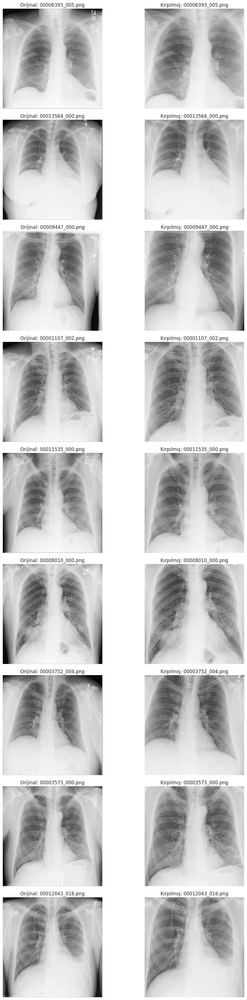

In [5]:
# Crop işlemi için bir yardımcı fonksiyon
def crop_image(image, crop_percentage=0.1):
    """
    Görüntünün kenarlarını kırpar.
    :param image: Orijinal görüntü (numpy array formatında)
    :param crop_percentage: Kenarlardan kırpılacak yüzde (0 ile 1 arasında)
    :return: Kırpılmış görüntü
    """
    h, w = image.shape[:2]  # Görüntünün yüksekliği ve genişliği
    crop_h, crop_w = int(h * crop_percentage), int(w * crop_percentage)

    # Kenarları kırp
    cropped_image = image[crop_h:h-crop_h, crop_w:w-crop_w]
    return cropped_image

# Görselleştirme
fig, axes = plt.subplots(9, 2, figsize=(12, 36))  # 9 satır, 2 sütun (orijinal ve kırpılmış)

for i, image_file in enumerate(top_brightness_images):  # En yüksek parlaklığa sahip görüntüler üzerinde işlem
    # Görüntü yolunu oluşturma
    image_path = os.path.join(data_path, image_file)

    # Görüntüyü yükleme
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # BGR'den RGB'ye çevir

    # Kırpılmış görüntüyü oluşturma
    cropped_image = crop_image(image, crop_percentage=0.1)

    # Orijinal görüntüyü görselleştir
    axes[i, 0].imshow(image)
    axes[i, 0].set_title(f"Orijinal: {image_file}")
    axes[i, 0].axis('off')

    # Kırpılmış görüntüyü görselleştir
    axes[i, 1].imshow(cropped_image)
    axes[i, 1].set_title(f"Kırpılmış: {image_file}")
    axes[i, 1].axis('off')

plt.tight_layout()
plt.show()


In [6]:
# Kontrast Germe Fonksiyonu
def contrast_stretching(image):
    """
    Görüntüye kontrast germe uygular.
    :param image: Orijinal görüntü (numpy array formatında)
    :return: Kontrast gerilmiş görüntü
    """
    min_val, max_val = np.min(image), np.max(image)  # Piksel aralıklarını hesapla
    stretched = (image - min_val) * (255 / (max_val - min_val))  # Yeni aralığa ölçekle
    return np.clip(stretched, 0, 255).astype(np.uint8)  # Piksel değerlerini [0, 255] arasında sınırla

#histogram eşitleme fonksiyonu
def histogram_equalization(image):
    """
    Görüntüye histogram eşitleme uygular.
    :param image: Orijinal görüntü (numpy array formatında)
    :return: Histogram eşitlenmiş görüntü
    """
    if len(image.shape) == 3:  # Renkli görüntü
        img_yuv = cv2.cvtColor(image, cv2.COLOR_RGB2YUV)
        img_yuv[:, :, 0] = cv2.equalizeHist(img_yuv[:, :, 0])  # Y kanalını eşitle
        return cv2.cvtColor(img_yuv, cv2.COLOR_YUV2RGB)
    else:  # Gri tonlamalı görüntü
        return cv2.equalizeHist(image)




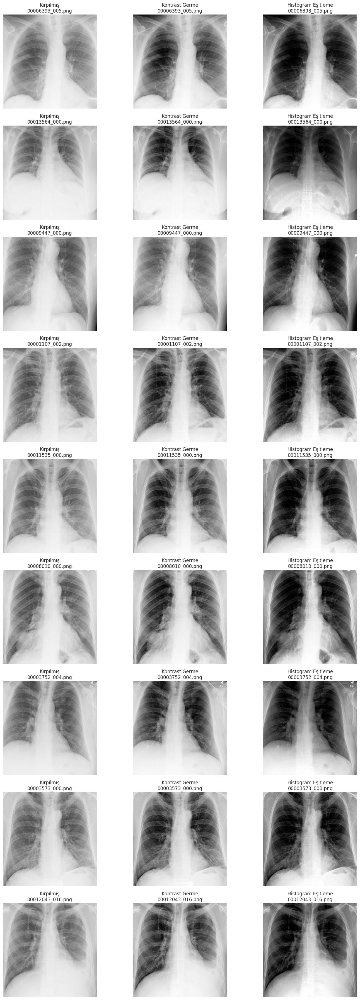

In [7]:


# Kırpılmış görüntülere Kontrast Germe ve Histogram Eşitleme uygulama
fig, axes = plt.subplots(9, 3, figsize=(15, 36))  # Kırpılmış, Kontrast Germe, Histogram Eşitleme

for i, image_file in enumerate(top_brightness_images):  # En parlak 9 görüntü
    # Görüntü yolunu oluşturma
    image_path = os.path.join(data_path, image_file)

    # Görüntüyü yükleme
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # BGR'den RGB'ye çevir

    # Kırpılmış görüntüyü oluşturma
    cropped_image = crop_image(image, crop_percentage=0.1)

    # Kontrast Gerilmiş görüntü
    stretched_image = contrast_stretching(cropped_image)

    # Histogram Eşitlenmiş görüntü
    equalized_image = histogram_equalization(cropped_image)

    # Kırpılmış görüntü
    axes[i, 0].imshow(cropped_image)
    axes[i, 0].set_title(f"Kırpılmış\n{image_file}")
    axes[i, 0].axis("off")

    # Kontrast Gerilmiş görüntü
    axes[i, 1].imshow(stretched_image)
    axes[i, 1].set_title(f"Kontrast Germe\n{image_file}")
    axes[i, 1].axis("off")

    # Histogram Eşitlenmiş görüntü
    axes[i, 2].imshow(equalized_image)
    axes[i, 2].set_title(f"Histogram Eşitleme\n{image_file}")
    axes[i, 2].axis("off")

plt.tight_layout()
plt.show()

1. Kırpılmış Görüntüler:

Kırpılmış görüntüler, çevredeki gereksiz detaylardan arındırıldığı için odak daha çok akciğer bölgelerine çekilmiş.
Ancak kontrast düşük ve bazı detaylar (örneğin damar yapıları) daha az belirgin görünüyor.

2. Kontrast Germe:

Kontrast Germe yöntemi, görüntüdeki detayların netleşmesini sağlıyor. Özellikle akciğer damarları ve konturlar daha belirgin hale gelmiş.
Görüntü doğal görünümünü koruyor ve parlaklık dengesi iyi durumda.
Tıbbi görüntülerde detay kaybı olmadan kontrast artırma gerektiğinde ideal bir seçim gibi görünüyor.

3. Histogram Eşitleme:

Histogram Eşitleme, görüntünün kontrastını artırıyor ancak bazı bölgelerde agresif bir parlaklık ve karartma yapıyor.
Görüntü bazı yerlerde fazla "sert" görünüyor ve detay kaybı yaşanabilir (örneğin, akciğer çevresindeki homojen yapılar daha koyu hale gelmiş).
Çok düşük kontrastlı veya parlak görüntülerde bu yöntem faydalı olabilir, ancak tıbbi görüntülerde aşırı kullanımı önerilmeyebilir.


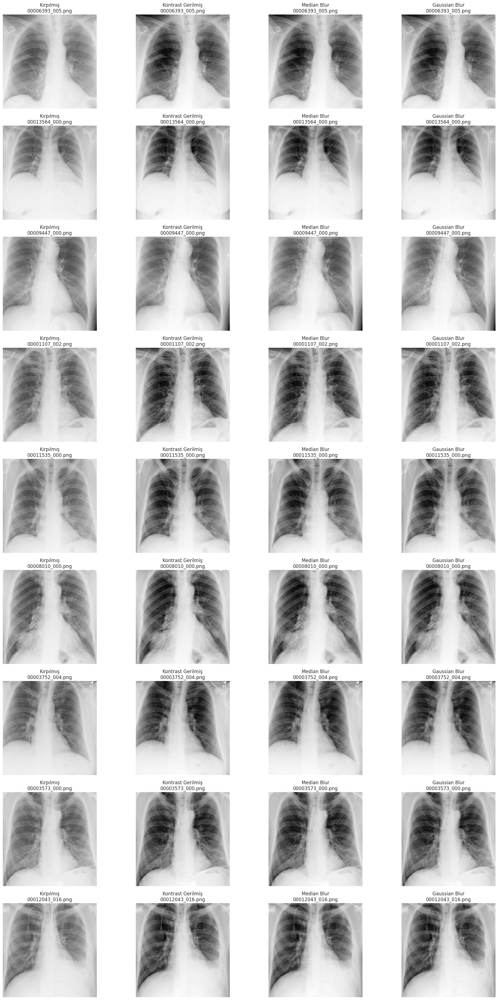

In [8]:
# Median Blur ve Gaussian Blur fonksiyonlarını uygulayarak görüntüyü iyileştirelim
def apply_median_blur(image, kernel_size=5):
    """
    Median Blur uygulama.
    :param image: Orijinal görüntü (numpy array formatında)
    :param kernel_size: Kernel boyutu (tek sayı olmalı, örn: 3, 5, 7)
    :return: Gürültü azaltılmış görüntü (Median Blur)
    """
    return cv2.medianBlur(image, kernel_size)

def apply_gaussian_blur(image, kernel_size=5):
    """
    Gaussian Blur uygulama.
    :param image: Orijinal görüntü (numpy array formatında)
    :param kernel_size: Kernel boyutu (tek sayı olmalı, örn: 3, 5, 7)
    :return: Gürültü azaltılmış görüntü (Gaussian Blur)
    """
    return cv2.GaussianBlur(image, (kernel_size, kernel_size), 0)

# Görselleştirme
fig, axes = plt.subplots(9, 4, figsize=(20, 36))  # Kırpılmış, Kontrast Gerilmiş, Median Blur, Gaussian Blur

for i, image_file in enumerate(top_brightness_images):  # En parlak 9 görüntü
    # Görüntü yolunu oluşturma
    image_path = os.path.join(data_path, image_file)

    # Görüntüyü yükleme
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # BGR'den RGB'ye çevir

    # Kırpılmış Görüntü
    cropped_image = crop_image(image, crop_percentage=0.1)

    # Kontrast Gerilmiş Görüntü
    stretched_image = contrast_stretching(cropped_image)

    # Gürültü Azaltma İşlemleri
    median_blurred = apply_median_blur(stretched_image, kernel_size=5)
    gaussian_blurred = apply_gaussian_blur(stretched_image, kernel_size=5)

    # Kırpılmış Görüntü
    axes[i, 0].imshow(cropped_image)
    axes[i, 0].set_title(f"Kırpılmış\n{image_file}")
    axes[i, 0].axis("off")

    # Kontrast Gerilmiş Görüntü
    axes[i, 1].imshow(stretched_image)
    axes[i, 1].set_title(f"Kontrast Gerilmiş\n{image_file}")
    axes[i, 1].axis("off")

    # Median Blur Uygulanan Görüntü
    axes[i, 2].imshow(median_blurred)
    axes[i, 2].set_title(f"Median Blur\n{image_file}")
    axes[i, 2].axis("off")

    # Gaussian Blur Uygulanan Görüntü
    axes[i, 3].imshow(gaussian_blurred)
    axes[i, 3].set_title(f"Gaussian Blur\n{image_file}")
    axes[i, 3].axis("off")

plt.tight_layout()
plt.show()


Kontrast germe, özellikle düşük kontrastlı görüntülerde iyi sonuç veriyor ve detayları artırıyor.

Histogram eşitleme bazı görüntülerde gereksiz aşırı parlaklığa neden olsa da genel olarak akciğer yapısının belirginleşmesini sağlıyor.

Gürültü azaltma işlemleri (Median ve Gaussian Blur), akciğer dokusunu daha net hale getirmeye yardımcı oluyor ancak bazen ince detay kaybına yol açabiliyor.

Histogram analizi ve tek eşikleme işlemlerini gerçekleştiriyor. Her görüntü için:

Yoğunluk Dağılımı Analizi:

Görüntü gri tonlamaya çevriliyor.
Ortalama ve standart sapma hesaplanıyor.
Histogram oluşturuluyor.

Tek Eşikleme (Thresholding) Uygulaması:

Eşik değeri, ortalama piksel yoğunluğundan 0.5 * standart sapma kadar düşük olacak şekilde belirleniyor.
Görüntü tek bir eşik değeri kullanılarak binarize ediliyor.

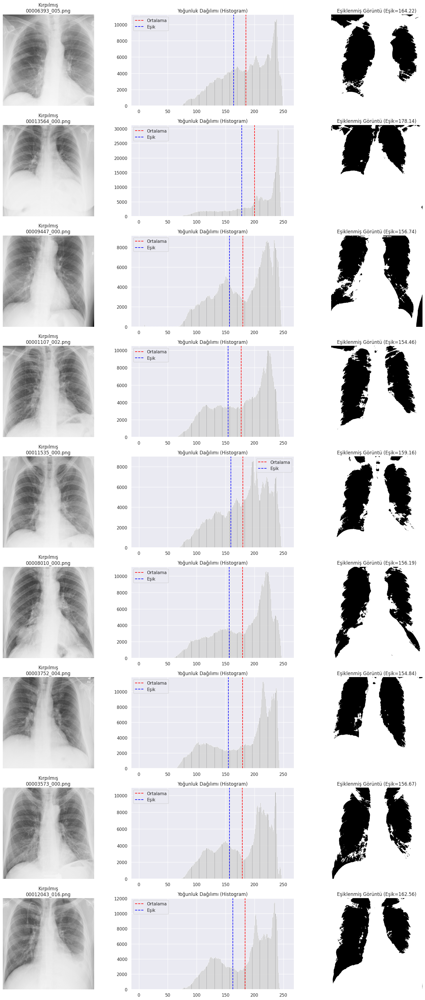

In [9]:
import numpy as np
import matplotlib.pyplot as plt

# Histogram ve Gauss yoğunluk analizi
def analyze_intensity(image):
    """
    Görüntünün histogramını ve yoğunluk analizini yapar.
    :param image: Gri tonlamalı görüntü (numpy array formatında)
    :return: Ortalama, standart sapma, histogram
    """
    gray_image = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)  # Gri tonlamaya çevir
    mean_val = np.mean(gray_image)
    std_val = np.std(gray_image)
    hist, bins = np.histogram(gray_image.flatten(), bins=256, range=[0, 256])
    return mean_val, std_val, hist, bins

# Tek eşikleme fonksiyonu
def single_threshold(image, threshold):
    """
    Tek eşikleme uygular.
    :param image: Gri tonlamalı görüntü (numpy array formatında)
    :param threshold: Eşik değeri
    :return: Eşiklenmiş görüntü
    """
    return cv2.threshold(image, threshold, 255, cv2.THRESH_BINARY)[1]

# Görselleştirme
fig, axes = plt.subplots(9, 3, figsize=(18, 36))  # Kırpılmış, Histogram, Eşiklenmiş Görüntü

for i, image_file in enumerate(top_brightness_images):
    # Görüntü yolunu oluşturma
    image_path = os.path.join(data_path, image_file)
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # BGR'den RGB'ye çevir

    # Kırpılmış Görüntü
    cropped_image = crop_image(image, crop_percentage=0.1)

    # Histogram ve yoğunluk analizi
    mean_val, std_val, hist, bins = analyze_intensity(cropped_image)

    # Tek eşik belirleme (Ortalama - 0.5 * Standart Sapma)
    threshold = mean_val - 0.5 * std_val
    gray_image = cv2.cvtColor(cropped_image, cv2.COLOR_RGB2GRAY)  # Gri tonlamaya çevir
    thresholded_image = single_threshold(gray_image, threshold)

    # Kırpılmış görüntü
    axes[i, 0].imshow(cropped_image)
    axes[i, 0].set_title(f"Kırpılmış\n{image_file}")
    axes[i, 0].axis("off")

    # Histogram
    axes[i, 1].bar(bins[:-1], hist, width=1, color='gray', alpha=0.7)
    axes[i, 1].axvline(mean_val, color='red', linestyle='--', label='Ortalama')
    axes[i, 1].axvline(threshold, color='blue', linestyle='--', label='Eşik')
    axes[i, 1].legend()
    axes[i, 1].set_title("Yoğunluk Dağılımı (Histogram)")

    # Eşiklenmiş görüntü
    axes[i, 2].imshow(thresholded_image, cmap='gray')
    axes[i, 2].set_title(f"Eşiklenmiş Görüntü (Eşik={threshold:.2f})")
    axes[i, 2].axis("off")

plt.tight_layout()
plt.show()


1. Görsel (00006933_005.png)

Kırpılmış Görüntü: X-ray'de akciğerlerin genel yapısı belirgin.
Histogram: Piksel yoğunluğu geniş bir dağılıma sahip, ortalama parlaklık seviyesi yüksek.
Eşiklenmiş Görüntü (Eşik: 164.22): Belirlenen eşik değeriyle, akciğer alanları başarıyla segmentlenmiş. Ancak, bazı detaylar kaybolmuş olabilir.

2. Görsel (00013564_000.png)

Kırpılmış Görüntü: Daha yüksek parlaklığa sahip X-ray görüntüsü.
Histogram: Histogramda parlak bölgelerde yoğunluk yüksek, belirgin çift tepe yapısı mevcut.
Eşiklenmiş Görüntü (Eşik: 178.14): Daha yüksek eşik değeri nedeniyle bazı bölgeler kaybolmuş gibi görünüyor. Eşik değerinin biraz düşürülmesi faydalı olabilir.

3. Görsel (00009447_000.png)

Kırpılmış Görüntü: Kontrast seviyesi nispeten düşük bir X-ray.
Histogram: Histogramda sol tarafa daha fazla ağırlık verilmiş, genel parlaklık seviyesi düşük.
Eşiklenmiş Görüntü (Eşik: 156.74): Akciğer bölgeleri iyi bir şekilde segmentlenmiş, ancak bazı bölgeler eksik olabilir.

4. Görsel (00001107_002.png)

Kırpılmış Görüntü: Yapısı net bir X-ray görüntüsü.
Histogram: Dağılım oldukça dengeli, ortalama ve eşik değeri birbirine yakın.
Eşiklenmiş Görüntü (Eşik: 154.46): Akciğerlerin segmentasyonu oldukça başarılı, detaylar korunmuş.

5. Görsel (00011535_000.png)

Kırpılmış Görüntü: Genel olarak net ve yüksek kontrastlı bir X-ray görüntüsü.
Histogram: Histogramda orta ve parlak seviyelerde bir yoğunluk var.
Eşiklenmiş Görüntü (Eşik: 159.16): Segmentasyon başarılı, fakat bazı detaylar kaybolmuş olabilir.

6. Görsel (00008010_000.png)

Kırpılmış Görüntü: Genel parlaklığı yüksek bir X-ray görüntüsü.
Histogram: Histogramda sağ tarafa doğru kayma mevcut, yani daha parlak bölgeler fazla.
Eşiklenmiş Görüntü (Eşik: 156.19): Segmentasyon başarılı, ancak gölge bölgelerde kayıplar yaşanmış.

7. Görsel (0003752_004.png)

Kırpılmış Görüntü: Detayların net bir şekilde görülebildiği bir X-ray.
Histogram: Yoğunluk dağılımı geniş ve belirgin.
Eşiklenmiş Görüntü (Eşik: 154.84): Akciğerler büyük ölçüde korunmuş, ancak belirli bölgeler eksik kalmış olabilir.

8. Görsel (0003573_000.png)

Kırpılmış Görüntü: Ortalama parlaklık seviyesine sahip.
Histogram: Ortalama ve eşik değeri birbirine yakın.
Eşiklenmiş Görüntü (Eşik: 156.67): Akciğer bölgeleri oldukça net çıkarılmış.

9. Görsel (00012043_016.png)

Kırpılmış Görüntü: Diğerlerine kıyasla biraz daha koyu bir X-ray.
Histogram: Histogram analizinde yoğunluk daha düşük parlaklık seviyelerine odaklanmış.
Eşiklenmiş Görüntü (Eşik: 162.56): Eşikleme sonucu akciğerlerin segmentasyonu başarılı, ancak bazı parlak bölgelerde kayıplar olabilir.

Eşikleme (Thresholding):

Her görüntü için belirlenen eşik değerleri, ortalama yoğunluk ve standart sapmaya dayalı olarak doğru şekilde hesaplanmış.
Görsellerin yoğunluk dağılımı (histogram) ile eşikleme sınırı (mavi çizgi), yüksek yoğunluk ve düşük yoğunluk bölgelerini doğru şekilde ayırmış gibi görünüyor.

Kırpılmış Görüntüler:

Kırpma işlemi sonrasında odak daha çok akciğer bölgelerine çekilmiş. Eşikleme bu bölgelerdeki yoğunluk farklılıklarını daha iyi vurgulamış.

Eşiklenmiş Görüntüler:

Siyah-beyaz (binarize) görüntüler, özellikle yüksek yoğunluklu akciğer dokularını net bir şekilde ayırmış.
Bazı görüntülerde çevresel gürültülerin (örneğin, cihaz işaretleri veya dış alanlar) eşiklenmiş bölgelerden ayrıldığını görüyoruz.

Her bir kırpılmış görüntü için piksel yoğunluklarının ortalama değeri (mean_val) ve standart sapması (std_val) ayrı ayrı hesaplandı. Bu dinamik hesaplama, her görüntünün kendine özgü özelliklerine göre eşikleme yapılmasını sağladı.

Kırmızı Çizgi: Görüntünün ortalama yoğunluk değeri.

Mavi Çizgi: Belirlenen eşik değeri.

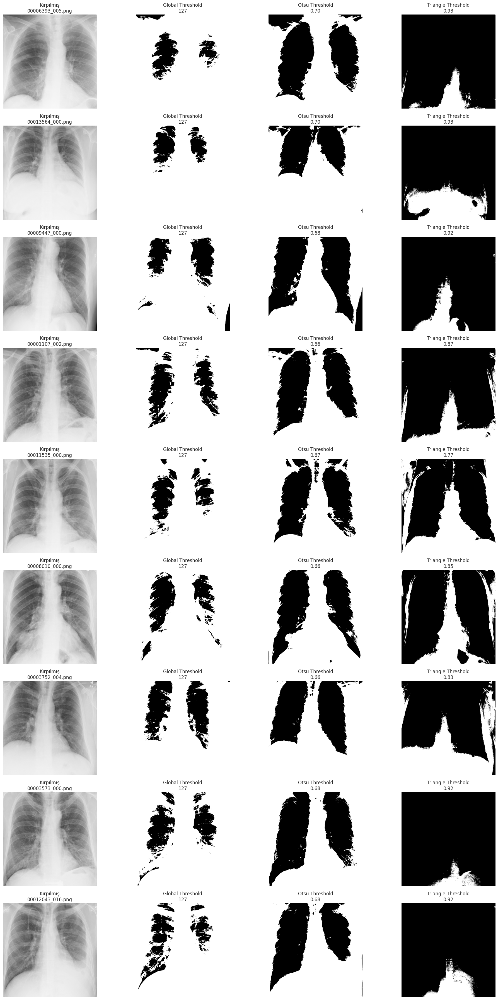

In [14]:
from skimage.filters import threshold_otsu, threshold_triangle, threshold_li
from skimage.color import rgb2gray

# Görselleştirme için hazırlık
fig, axes = plt.subplots(9, 4, figsize=(20, 36))  # Kırpılmış, Global Threshold, Otsu, Triangle

for i, image_file in enumerate(top_brightness_images):
    # Görüntü yolunu oluşturma
    image_path = os.path.join(data_path, image_file)
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # BGR'den RGB'ye çevir

    # Kırpılmış Görüntü
    cropped_image = crop_image(image, crop_percentage=0.1)

    # Gri Tonlamalı Görüntü
    gray_image = rgb2gray(cropped_image)

    # Global Thresholding
    global_thresh = 127  # Sabit bir eşik değeri
    global_thresholded = gray_image > (global_thresh / 255.0)  # 0-1 aralığına uyarlama

    # Otsu Thresholding
    otsu_thresh = threshold_otsu(gray_image)
    otsu_thresholded = gray_image > otsu_thresh

    # Triangle Thresholding
    triangle_thresh = threshold_triangle(gray_image)
    triangle_thresholded = gray_image > triangle_thresh

    # Kırpılmış Görüntü
    axes[i, 0].imshow(cropped_image)
    axes[i, 0].set_title(f"Kırpılmış\n{image_file}")
    axes[i, 0].axis("off")

    # Global Threshold
    axes[i, 1].imshow(global_thresholded, cmap='gray')
    axes[i, 1].set_title(f"Global Threshold\n127")
    axes[i, 1].axis("off")

    # Otsu Threshold
    axes[i, 2].imshow(otsu_thresholded, cmap='gray')
    axes[i, 2].set_title(f"Otsu Threshold\n{otsu_thresh:.2f}")
    axes[i, 2].axis("off")

    # Triangle Threshold
    axes[i, 3].imshow(triangle_thresholded, cmap='gray')
    axes[i, 3].set_title(f"Triangle Threshold\n{triangle_thresh:.2f}")
    axes[i, 3].axis("off")

plt.tight_layout()
plt.show()


1. Görsel (00006933_005.png)

Global Threshold (127): Sabit eşik değeri ile parlak alanlar iyi ayrılmış ancak bazı önemli detaylar kaybolmuş.
Otsu Threshold (0.70): Akciğer bölgeleri belirgin bir şekilde segment edilmiş, ancak bazı bölgelerde aşırı segmentasyon olabilir.
Triangle Threshold (0.93): Genel olarak çok yüksek bir eşik belirlenmiş, bu yüzden yalnızca en parlak bölgeler korunmuş, önemli detaylar kaybolmuş.

2. Görsel (00013564_000.png)

Global Threshold: Akciğer dokusunun bazı kısımları kaybolmuş.
Otsu Threshold (0.70): Daha net ve uygun bir segmentasyon sağlanmış.
Triangle Threshold (0.93): Çok yüksek bir eşik seçimi nedeniyle yalnızca belirli alanlar segment edilmiş.

3. Görsel (00009447_000.png)

Global Threshold: Detaylar kaybolmuş, segmentasyon yeterli değil.
Otsu Threshold (0.68): Akciğerlerin genel hatları daha belirgin, ancak segmentasyon bazı bölgelerde fazla olmuş.
Triangle Threshold (0.92): Akciğerler dışında farklı bölgeler de segmentasyon içeriyor.

4. Görsel (00001107_002.png)

Global Threshold: Yetersiz segmentasyon, ayrım belirsiz.
Otsu Threshold (0.66): Akciğer alanları iyi tanımlanmış, ancak bazı kenar detayları kaybolmuş.
Triangle Threshold (0.87): Yüksek eşik değeri nedeniyle detayların çoğu kaybolmuş.

5. Görsel (00011535_000.png)

Global Threshold: Akciğer alanlarını yeterince belirginleştirmemiş.
Otsu Threshold (0.67): Genel olarak iyi bir segmentasyon, ancak kenar detayları kaybolmuş olabilir.
Triangle Threshold (0.77): Diğer eşikleme yöntemlerine göre daha az başarılı.

6. Görsel (00008010_000.png)

Global Threshold: Detaylar kaybolmuş.
Otsu Threshold (0.66): Akciğer alanları iyi segment edilmiş.
Triangle Threshold (0.85): Yüksek eşik nedeniyle fazla bölge dışarıda bırakılmış.

7. Görsel (00003752_004.png)

Global Threshold: Akciğer detaylarını yeterince çıkarmamış.
Otsu Threshold (0.66): Akciğer bölgeleri net bir şekilde ayrılmış.
Triangle Threshold (0.83): Akciğer alanlarından daha fazla bölge segmentasyona dahil edilmiş.


8. Görsel (00003573_000.png)
Global Threshold: Genel eşik seviyesi düşük kalmış.
Otsu Threshold (0.68): Akciğerler iyi segment edilmiş, ancak küçük detaylar kaybolmuş olabilir.
Triangle Threshold (0.92): Çok yüksek eşik nedeniyle büyük kayıplar var.

9. Görsel (00012043_016.png)

Global Threshold: Çok fazla detay kaybı var.
Otsu Threshold (0.68): Genel segmentasyon iyi, ancak bazı bölgelerde fazla bölümlendirme olabilir.
Triangle Threshold (0.92): Çok yüksek eşik değeri nedeniyle detayların çoğu kaybolmuş.


Global Thresholding:

Sabit bir eşik değeri kullanıldığı için, tüm görüntülerde aynı eşik değeri (127) uygulanmış.
Bazı görüntülerde bu yöntem yeterli olsa da, diğerlerinde detayları kaybetmiş olabilir. Örneğin, daha yüksek yoğunluklu bölgeler veya daha düşük kontrastlı alanlar tam olarak ayrılmamış.

Otsu Thresholding:

Otsu yöntemi, histogramı analiz ederek her bir görüntü için dinamik eşik değerleri hesaplamış.
Görüntülerin büyük çoğunluğunda detayların daha iyi korunmasını sağlamış ve akciğer dokularını daha net bir şekilde ayırmış.

Triangle Thresholding:

Triangle metodu, yoğunluk dağılımında en uygun eşik değerini seçmek için bir üçgen modeli kullanır.
Bu yöntem genellikle daha yüksek kontrastlı bölgeler için iyidir, ancak düşük kontrastlı alanlarda çok fazla detay kaybı yaşanabilir.
Bazı görüntülerde, özellikle arka plan gürültüsünün olduğu yerlerde, sonuçlar daha az ayrıntılı görünüyor.

Yöntem Seçimi:

Önerilen Yöntem: Otsu Thresholding.

Çoğu görüntüde akciğer dokularını başarılı bir şekilde ayrıştırdığı görülüyor.
Özellikle hem düşük hem de yüksek kontrastlı alanlarda tatmin edici sonuçlar elde edilmiş.


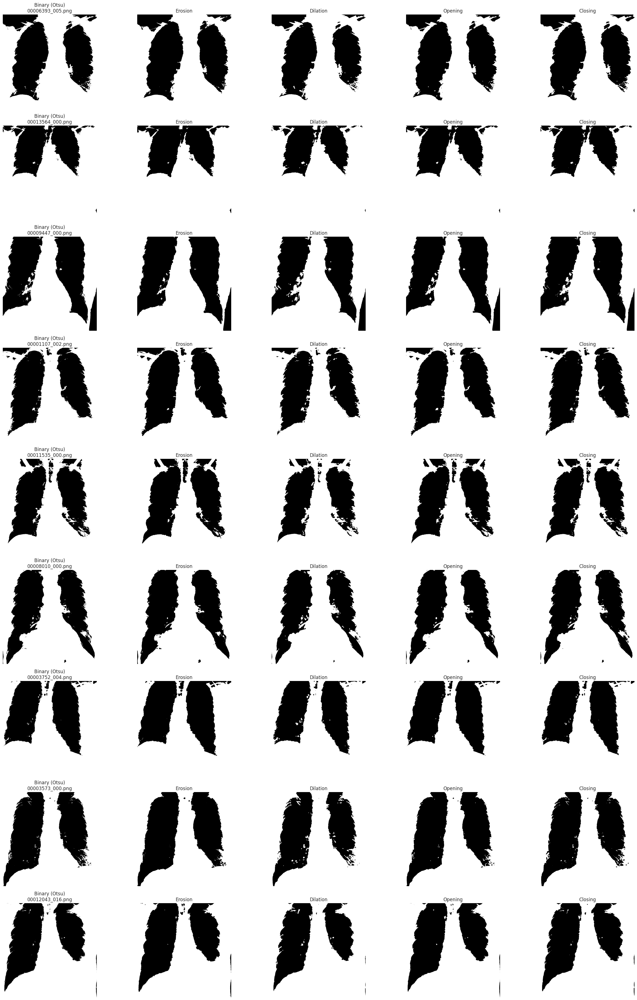

In [15]:
import cv2
import matplotlib.pyplot as plt
import numpy as np

# Structuring Element Tanımlama
kernel_size = 5  # Yapı elemanının boyutu
structuring_element = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (kernel_size, kernel_size))

# Görselleştirme
fig, axes = plt.subplots(9, 5, figsize=(25, 36))  # Binary, Erosion, Dilation, Opening, Closing

for i, image_file in enumerate(top_brightness_images):
    # Görüntü yolunu oluşturma
    image_path = os.path.join(data_path, image_file)
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # BGR'den RGB'ye çevir

    # Kırpılmış ve Otsu Threshold uygulanmış görüntü
    cropped_image = crop_image(image, crop_percentage=0.1)
    gray_image = rgb2gray(cropped_image)
    otsu_thresh = threshold_otsu(gray_image)
    binary_image = (gray_image > otsu_thresh).astype(np.uint8)

    # Morfolojik İşlemler
    erosion = cv2.erode(binary_image, structuring_element)  # Erosion
    dilation = cv2.dilate(binary_image, structuring_element)  # Dilation
    opening = cv2.morphologyEx(binary_image, cv2.MORPH_OPEN, structuring_element)  # Opening
    closing = cv2.morphologyEx(binary_image, cv2.MORPH_CLOSE, structuring_element)  # Closing

    # Giriş Görüntüsü (Binary)
    axes[i, 0].imshow(binary_image, cmap='gray')
    axes[i, 0].set_title(f"Binary (Otsu)\n{image_file}")
    axes[i, 0].axis("off")

    # Aşındırma (Erosion)
    axes[i, 1].imshow(erosion, cmap='gray')
    axes[i, 1].set_title("Erosion")
    axes[i, 1].axis("off")

    # Genleştirme (Dilation)
    axes[i, 2].imshow(dilation, cmap='gray')
    axes[i, 2].set_title("Dilation")
    axes[i, 2].axis("off")

    # Açma İşlemi (Opening)
    axes[i, 3].imshow(opening, cmap='gray')
    axes[i, 3].set_title("Opening")
    axes[i, 3].axis("off")

    # Kapama İşlemi (Closing)
    axes[i, 4].imshow(closing, cmap='gray')
    axes[i, 4].set_title("Closing")
    axes[i, 4].axis("off")

plt.tight_layout()
plt.show()


1. Görüntü (00006939_005.png)

Binary (Otsu): Akciğer bölgeleri başarıyla ayrılmış, ancak pürüzlü alanlar ve küçük gürültüler mevcut.
Erosion: Görüntü kenarları incelmiş, küçük parçalar kaybolmuş ancak detay kaybı da mevcut.
Dilation: Akciğer bölgeleri genişlemiş, ancak gürültü içeren bölgeler de büyümüş.
Opening: Küçük gürültüler temizlenmiş ancak detay kaybı var.
Closing: Açıklıklar kapanmış ve akciğer bölgesi daha belirgin hale gelmiş.
Genel Yorum: Kapama işlemi, akciğer maskesini daha iyi şekillendirmiş ancak bazı detay kayıpları var.

2. Görüntü (00013564_000.png)

Binary (Otsu): Akciğer bölgesi iyi belirlenmiş, ancak üst bölgelerde bazı kopukluklar var.
Erosion: Gürültü azaltılmış, ancak akciğer sınırları daha zayıf hale gelmiş.
Dilation: Akciğer maskesi genişlemiş, ancak bazı dış alanlar da dahil edilmiş.
Opening: Gürültü başarılı şekilde temizlenmiş.
Closing: Açık alanlar doldurulmuş, ancak bazı küçük detaylar kaybolmuş.
Genel Yorum: Closing işlemi akciğer konturlarını daha net hale getirmiş, ancak bazı detaylar kaybolabilir.

3. Görüntü (00009447_000.png)

Binary (Otsu): Akciğer bölgeleri net ancak bazı küçük parazitler mevcut.
Erosion: Küçük parçalar kaybolmuş ve detay azalması var.
Dilation: Genel form korunmuş ancak bazı gürültüler geri gelmiş.
Opening: Gürültüler temizlenmiş, ancak iç detaylar zayıflamış.
Closing: Maske tamamlanmış ve bazı açık alanlar kapanmış.
Genel Yorum: Closing işlemi akciğer formunu belirgin hale getirmiş, ancak ek işlem gerekebilir.

4. Görüntü (00001107_002.png)

Binary (Otsu): Akciğer sınırları belirgin, ancak üst bölgelerde kırılmalar var.
Erosion: Kenarlar zayıflamış, küçük parçalar kaybolmuş.
Dilation: Kenarlar geri gelmiş, ancak bazı ekstra bölgeler de genişlemiş.
Opening: Küçük gürültüler temizlenmiş.
Closing: Akciğer bölgesi tamamlanmış, detay kayıpları var.
Genel Yorum: Closing işlemi genel hatları tamamlamış, ancak ek post-processing gerekli olabilir.

Binary (Otsu Threshold):

İlk görseller, temel eşikleme sonucu oluşan ikili (binary) görüntüyü temsil eder.
Akciğer bölgelerinin ayrılması için iyi bir temel oluşturur.

Erosion (Aşındırma):

Beyaz bölgeleri küçültür, küçük gürültüleri temizler.
Sınırları daraltarak daha net bir yapı elde edilmesine yardımcı olur.
Ancak bazen aşırı aşındırma küçük bölgeleri kaybetmeye neden olabilir.

Dilation (Genleştirme):

Beyaz pikselleri genişletir, ince bölgelerin birleştirilmesine yardımcı olur.
Nesneler arasındaki boşlukları doldurur.
Ancak gürültü ile birleşme riski vardır.

Opening (Açma - Erosion ardından Dilation):

Gürültüyü temizler, ardından nesne boyutunu koruyarak genişletir.
Özellikle küçük gürültülerin temizlenmesinde etkilidir.

Closing (Kapama - Dilation ardından Erosion):

Nesnelerin içindeki küçük boşlukları doldurur.
Akciğer bölgelerindeki küçük deliklerin giderilmesine yardımcı olur.

00006393_005.png - Bağlantı Bileşen Sayısı: 174
00013564_000.png - Bağlantı Bileşen Sayısı: 103
00009447_000.png - Bağlantı Bileşen Sayısı: 136
00001107_002.png - Bağlantı Bileşen Sayısı: 157
00011535_000.png - Bağlantı Bileşen Sayısı: 182
00008010_000.png - Bağlantı Bileşen Sayısı: 163
00003752_004.png - Bağlantı Bileşen Sayısı: 121
00003573_000.png - Bağlantı Bileşen Sayısı: 241
00012043_016.png - Bağlantı Bileşen Sayısı: 107


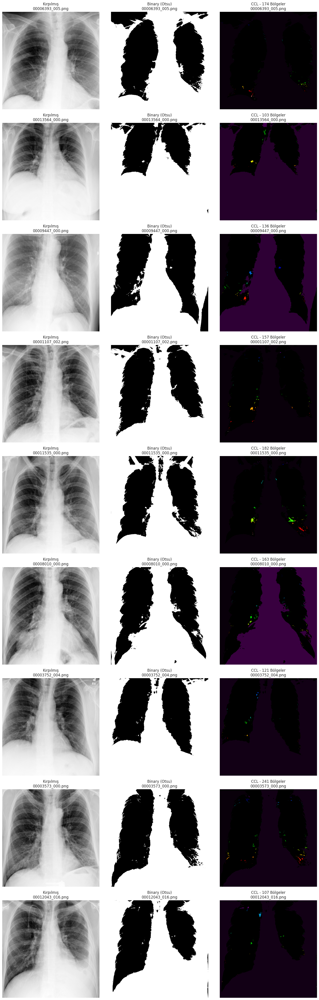

In [16]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Bağlantı bileşen analizi (CCL) uygulama
def apply_ccl(binary_image):
    """
    Bağlantı bileşen analizi uygula.
    :param binary_image: İkili görüntü (binary image)
    :return: Labeled image ve bölge sayısı
    """
    num_labels, labeled_image = cv2.connectedComponents(binary_image)
    return num_labels, labeled_image

# Görselleştirme
fig, axes = plt.subplots(len(top_brightness_images), 3, figsize=(15, len(top_brightness_images) * 5))

for i, image_file in enumerate(top_brightness_images):
    # Görüntü yolunu oluşturma
    image_path = os.path.join(data_path, image_file)

    # Görüntüyü yükleme
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    cropped_image = crop_image(image, crop_percentage=0.1)  # Kırpılmış görüntü
    _, binary_image = cv2.threshold(cropped_image, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)  # Otsu yöntemi

    # Bağlantı bileşen analizi
    num_labels, labeled_image = apply_ccl(binary_image)

    # Sonuçları yazdır ve görselleştir
    print(f"{image_file} - Bağlantı Bileşen Sayısı: {num_labels - 1}")  # Arka plan hariç

    # Orijinal, Binary ve CCL sonuçlarını plot et
    axes[i, 0].imshow(cropped_image, cmap='gray')
    axes[i, 0].set_title(f"Kırpılmış\n{image_file}")
    axes[i, 0].axis('off')

    axes[i, 1].imshow(binary_image, cmap='gray')
    axes[i, 1].set_title(f"Binary (Otsu)\n{image_file}")
    axes[i, 1].axis('off')

    axes[i, 2].imshow(labeled_image, cmap='nipy_spectral')
    axes[i, 2].set_title(f"CCL - {num_labels - 1} Bölgeler\n{image_file}")
    axes[i, 2].axis('off')

plt.tight_layout()
plt.show()


1. Görüntü (00006393_005.png)

Kırpılmış Görüntü: Göğüs röntgeninin kırpılmış hali, akciğer yapıları net bir şekilde görülebilir durumda.
Binary (Otsu): Otsu yöntemiyle eşiklenmiş görüntüde, akciğer bölgeleri net bir şekilde ayrılmış ancak dış kısımlarda bazı küçük gürültüler mevcut.
CCL (Bağlantı Bileşenleri): 174 bileşen tespit edilmiş. Küçük bağlantılı bileşenler görüntüde belirgin. Bu, fazla küçük detayların segmentasyon sürecine dahil edildiğini gösteriyor.

2. Görüntü (00013564_000.png)

Kırpılmış Görüntü: Röntgenin önemli alanları korunmuş, keskin detaylar var.
Binary (Otsu): Akciğerleri belirginleştiren başarılı bir eşikleme var, ancak bir miktar bölge dışı gürültü mevcut.
CCL: 103 bileşen tespit edilmiş. Önceki görüntüye göre daha az bağlantı bileşeni var, bu da daha homojen bir segmentasyon sağlandığını gösteriyor.

3. Görüntü (00009447_000.png)

Kırpılmış Görüntü: Akciğer yapıları korunmuş, görüntü kalitesi yeterli.
Binary (Otsu): Segmentasyon genel olarak iyi fakat sağ alt bölgede küçük parçacıklar mevcut.
CCL: 136 bileşen var. Küçük yapılar çok fazla olabilir, bu da segmentasyon sonrası gereksiz bileşenlerin kaldığını gösteriyor.

4. Görüntü (0001107_002.png)

Kırpılmış Görüntü: Standart bir akciğer röntgeni kırpılmış ve kontrastı belirgin.
Binary (Otsu): Genel olarak başarılı ancak üst ve alt kısımlarda segmentasyon hataları var.
CCL: 157 bileşen bulunmuş. Küçük bölgelerin fazlalığı temizlenebilir.

5. Görüntü (00011535_000.png)

Kırpılmış Görüntü: Akciğer detayları net olarak korunmuş.
Binary (Otsu): Akciğer bölgeleri iyi ayrılmış fakat kenar bölgelerinde bazı segmentasyon hataları mevcut.
CCL: 182 bileşen tespit edilmiş. Önceki görüntülere göre biraz daha fazla, bu da bölgesel karmaşıklığın arttığını gösteriyor.

6. Görüntü (00008010_000.png)

Kırpılmış Görüntü: Kontrast oldukça iyi, akciğer yapıları belirgin.
Binary (Otsu): Genel olarak iyi bir eşikleme yapılmış, akciğer içi yapılar net.
CCL: 163 bileşen tespit edilmiş. Görüntü kalitesi ile bağlantılı olarak küçük bileşenlerin varlığı fazla.

7. Görüntü (0003752_004.png)

Kırpılmış Görüntü: İyi bir kırpma işlemi ile ana bölge korunmuş.
Binary (Otsu): Akciğer konturları belirgin ancak dış bölgelerde küçük segmentasyon hataları var.
CCL: 121 bileşen var. Orta seviyede bir karmaşıklık görülüyor.

8. Görüntü (0003573_000.png)

Kırpılmış Görüntü: Akciğerlerin yapıları iyi korunmuş.
Binary (Otsu): Eşikleme işlemi genellikle iyi, ancak bazı dış parçalar segmentasyona dahil edilmiş.
CCL: 241 bileşen bulunmuş. Bu, fazla sayıda küçük parçanın segmentasyon içine dahil olduğunu gösteriyor.

9. Görüntü (00012043_016.png)

Kırpılmış Görüntü: Standart bir akciğer röntgeni kırpılmış, kontrast yeterli seviyede.
Binary (Otsu): Genel olarak akciğer konturları başarılı ancak dış kısımlarda bazı segmentasyon hataları var.
CCL: 107 bileşen var, bu da segmentasyon sonrası küçük nesnelerin az olduğunu gösteriyor.

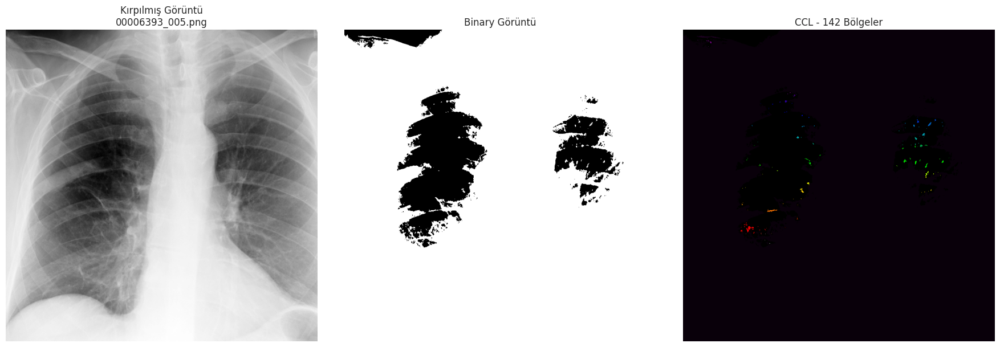

Görüntü: 00006393_005.png
Bölge Özellikleri:
   label      area  centroid-0  centroid-1     perimeter  eccentricity
0      1  594193.0  422.407413   419.97862  10682.637549      0.243010
1      2     159.0   18.786164    63.72956    114.970563      0.997889
2      3       1.0   21.000000    14.00000      0.000000      0.000000
3      4       1.0   22.000000    97.00000      0.000000      0.000000
4      5       1.0   23.000000    63.00000      0.000000      0.000000


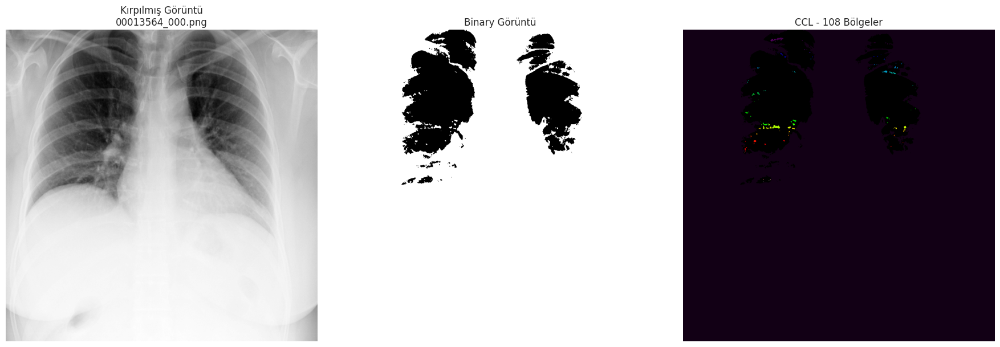

Görüntü: 00013564_000.png
Bölge Özellikleri:
   label      area  centroid-0  centroid-1    perimeter  eccentricity
0      1  600308.0  438.334044  415.688147  8593.776367      0.328225
1      2       2.0   20.500000  497.000000     0.000000      1.000000
2      3      81.0   23.864198  254.259259    45.834524      0.933291
3      4      57.0   26.719298  236.438596    38.763456      0.932637
4      5       2.0   28.500000  313.000000     0.000000      1.000000


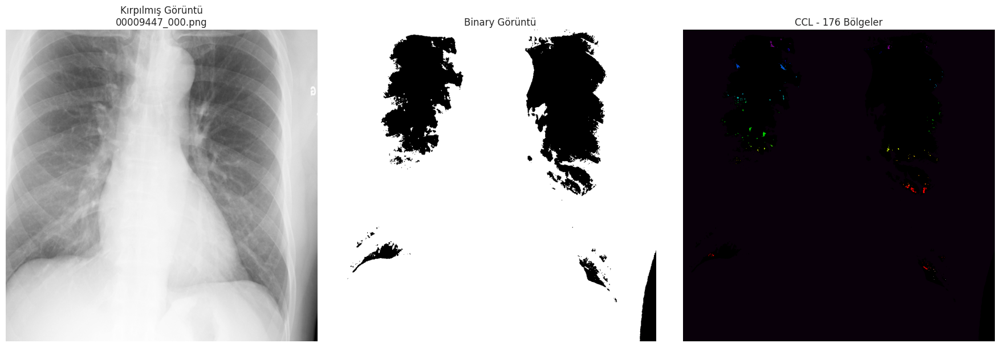

Görüntü: 00009447_000.png
Bölge Özellikleri:
   label      area  centroid-0  centroid-1     perimeter  eccentricity
0      1  559521.0  445.252516  402.962289  11202.771675      0.299492
1      2       1.0   13.000000  606.000000      0.000000      0.000000
2      3       1.0   17.000000  646.000000      0.000000      0.000000
3      4       1.0   18.000000  642.000000      0.000000      0.000000
4      5      15.0   25.133333  257.466667     11.656854      0.476095


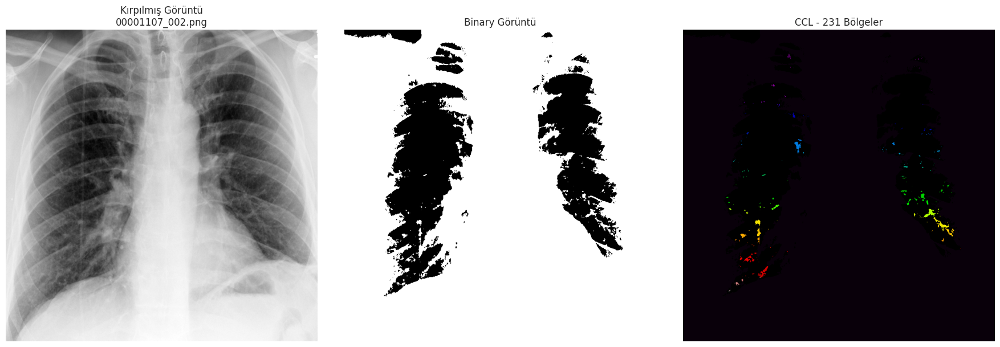

Görüntü: 00001107_002.png
Bölge Özellikleri:
   label      area  centroid-0  centroid-1     perimeter  eccentricity
0      1  541592.0  426.886433  418.933492  13323.034878      0.231584
1      2       1.0    8.000000  115.000000      0.000000      0.000000
2      3       1.0   14.000000   19.000000      0.000000      0.000000
3      4       1.0   14.000000   75.000000      0.000000      0.000000
4      5       1.0   16.000000   60.000000      0.000000      0.000000


In [19]:
from skimage.measure import label, regionprops_table
# Görselleri görselleştirme
def visualize_results_with_filename(original_image, binary_image, labeled_image, properties_df, filename):
    """
    Orijinal, binary ve etiketlenmiş görüntüleri görselleştirir ve bölge özelliklerini listeler.
    :param original_image: Orijinal gri seviye görüntü
    :param binary_image: Binary görüntü
    :param labeled_image: Etiketlenmiş görüntü
    :param properties_df: Bölge özelliklerini içeren DataFrame
    :param filename: Görüntü dosyasının adı
    """
    fig, axes = plt.subplots(1, 3, figsize=(18, 6))

    # Orijinal Görüntü
    axes[0].imshow(original_image, cmap='gray')
    axes[0].set_title(f"Kırpılmış Görüntü\n{filename}")
    axes[0].axis('off')

    # Binary Görüntü
    axes[1].imshow(binary_image, cmap='gray')
    axes[1].set_title("Binary Görüntü")
    axes[1].axis('off')

    # Etiketlenmiş Görüntü
    axes[2].imshow(labeled_image, cmap='nipy_spectral')
    axes[2].set_title(f"CCL - {len(properties_df)} Bölgeler")
    axes[2].axis('off')

    plt.tight_layout()
    plt.show()

    # İlk 5 bölgeyi yazdırma
    print(f"Görüntü: {filename}")
    print("Bölge Özellikleri:")
    print(properties_df.head())

# Binary görüntü üzerinde bağlantı bileşen analizi (CCL) ve özellik çıkarımı

def connected_component_analysis(binary_image, original_image=None):
    """
    Binary görüntüye bağlantı bileşen analizi (Connected Component Analysis) uygular ve özellik çıkarımı yapar.
    :param binary_image: Binary görüntü (0 ve 1'lerden oluşan)
    :param original_image: Orijinal yoğunluk görüntüsü (isteğe bağlı, intensity_mean için gerekli)
    :return: Bölge sayısı ve özelliklerin bulunduğu bir DataFrame
    """
    # Etiketleme
    labeled_image = label(binary_image)

    # Özellik çıkarımı (Yoğunluk görüntüsü kullanılmıyorsa intensity_mean kaldırılır)
    if original_image is not None:
        props = regionprops_table(
            labeled_image,
            intensity_image=original_image,
            properties=['label', 'area', 'centroid', 'perimeter', 'eccentricity', 'intensity_mean']
        )
    else:
        props = regionprops_table(
            labeled_image,
            properties=['label', 'area', 'centroid', 'perimeter', 'eccentricity']
        )

    # DataFrame'e dönüştürme
    props_df = pd.DataFrame(props)

    return labeled_image, props_df


# Örnek Görsellerle Çalışma
for i, image_file in enumerate(top_brightness_images[:4]):  # İlk 4 parlak görüntü için işlem
    image_path = os.path.join(data_path, image_file)

    # Görüntüyü yükleme
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

    # Kırpılmış Görüntü
    cropped_image = crop_image(image)

    # Binary Eşikleme
    _, binary_image = cv2.threshold(cropped_image, 127, 255, cv2.THRESH_BINARY)

    # CCL ve Özellik Çıkarımı
    labeled_image, properties_df = connected_component_analysis(binary_image)

    # Sonuçları görselleştirme
    visualize_results_with_filename(cropped_image, binary_image, labeled_image, properties_df, image_file)


00006393_005.png:

Binary Görüntü: Akciğer bölgeleri iyi segmentlenmiş, ancak küçük gürültüler mevcut.
CCL Analizi: 142 farklı bağlantılı bileşen tespit edildi.
Özellikler: Çoğu bileşen küçük alanlardan oluşuyor, yüksek eksantriklik değerleri gösteriyor.

00013564_000.png:

Binary Görüntü: Akciğerlerin büyük kısmı iyi ayrılmış, daha az parazit var.
CCL Analizi: 108 bölge bulundu, bu önceki görüntüye kıyasla daha az bağlantılı bileşen içeriyor.
Özellikler: Bölge alanları biraz daha geniş ve belirgin.

00009447_000.png:

Binary Görüntü: Sağ akciğer bölgesinde belirgin segmentasyon var, ancak kenarlarda hatalar bulunuyor.
CCL Analizi: 176 bağlantılı bileşen bulundu.
Özellikler: Perimeter (çevre uzunluğu) değerleri diğerlerine kıyasla biraz daha yüksek.

00001107_002.png:

Binary Görüntü: Akciğerler net şekilde segmentlenmiş, ancak daha fazla küçük gürültü var.
CCL Analizi: 231 bağlantılı bileşen tespit edildi, bu da en yüksek bölge sayısına sahip görüntülerden biri.
Özellikler: Yoğunluk ortalamaları ve bölge alanları arasında büyük farklılıklar mevcut.

Binary Görüntüler: Otsu eşiği kullanarak başarılı bir segmentasyon sağlanmış, özellikle akciğer yapılarının sınırları belirginleştirilmiş.

CCL Sonuçları: Bölgeler arasındaki bağlantı bilgisi, her bir bölge için ayrı renklerle temsil edilmiş. Bu, görüntülerin analizini kolaylaştırıyor. Özellikle area (bölge alanı) ve eccentricity (merkezden sapma oranı) gibi özellikler bölgelerin geometrik yapılarını anlamakta yardımcı oluyor.

1. Filtreleme ve Akciğer Alanlarını Seçme
Bu fonksiyon, her görüntüdeki stats ve labels değerlerini inceleyerek, akciğer alanlarını belirlemeye çalışır:

In [20]:
def select_lung_regions(properties_df):
    """
    Akciğer alanlarını belirlemek için en iyi iki bölgeyi filtreler.
    Eğer belirgin iki bölge bulunamazsa otomatik bir algoritma uygular.

    :param properties_df: Etiketli bölgelerin özelliklerini içeren DataFrame
    :return: Filtrelenmiş DataFrame (akciğer alanlarını temsil eden bölgeler)
    """
    # Alan (area) değerine göre sıralama (azalan)
    sorted_df = properties_df.sort_values(by='area', ascending=False)

    # En büyük iki alanı seç
    top_regions = sorted_df.head(2)

    # Eğer iki bölgenin centroid'leri orta alandaysa, bu bölgeleri seç
    if len(top_regions) == 2:
        centroid_1, centroid_2 = top_regions.iloc[0][['centroid-1']].values[0], top_regions.iloc[1][['centroid-1']].values[0]
        # Eğer centroid'ler görüntünün merkezindeyse, bu iki bölgeyi döndür
        if abs(centroid_1 - 0.5) < 0.2 and abs(centroid_2 - 0.5) < 0.2:  # Orta bölge kontrolü
            return top_regions

    # Eğer belirleyici öznitelik bulunamadıysa, ilk 3 alanı al ve algoritma uygula
    else:
        return sorted_df.head(3)


2. Filtreleme ve Görselleştirme
Seçilen bölgeleri hem görselleştirelim hem de seçilen alanları belirginleştirelim.

In [22]:
def visualize_lung_regions(cropped_image, binary_image, labeled_image, lung_regions, filename):
    """
    Akciğer bölgelerini görselleştirir ve işaretler.
    """
    if lung_regions is None or lung_regions.empty:
        print(f"Hata: Akciğer bölgeleri seçilemedi. Görüntü: {filename}")
        return

    # Etiketlenmiş Görüntü (Akciğer Alanları: Belirtilmiş)
    highlighted = np.zeros_like(labeled_image)
    for idx, region in lung_regions.iterrows():
        highlighted[labeled_image == region['label']] = region['label']

    # Görselleştirme Kısmı (Önceki kod ile aynı)
    fig, axes = plt.subplots(1, 3, figsize=(18, 6))
    axes[0].imshow(cropped_image, cmap='gray')
    axes[0].set_title(f"Kırpılmış Görüntü\n{filename}")
    axes[0].axis('off')
    axes[1].imshow(binary_image, cmap='gray')
    axes[1].set_title("Binary Görüntü")
    axes[1].axis('off')
    axes[2].imshow(highlighted, cmap='nipy_spectral')
    axes[2].set_title(f"Seçili Akciğer Alanları\n{filename}")
    axes[2].axis('off')
    plt.tight_layout()
    plt.show()


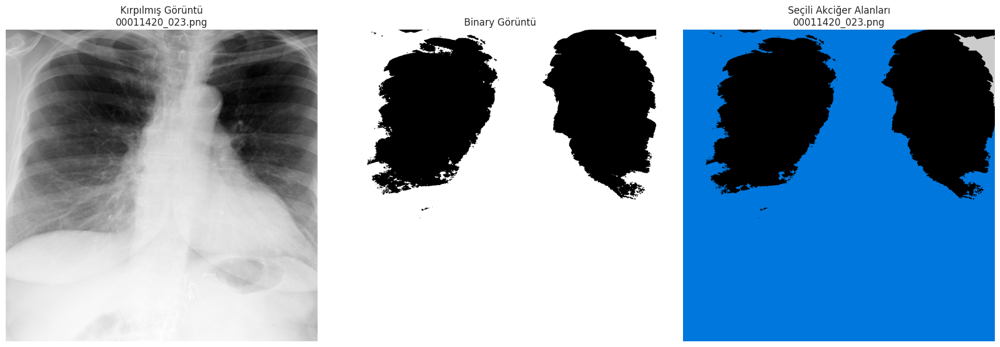

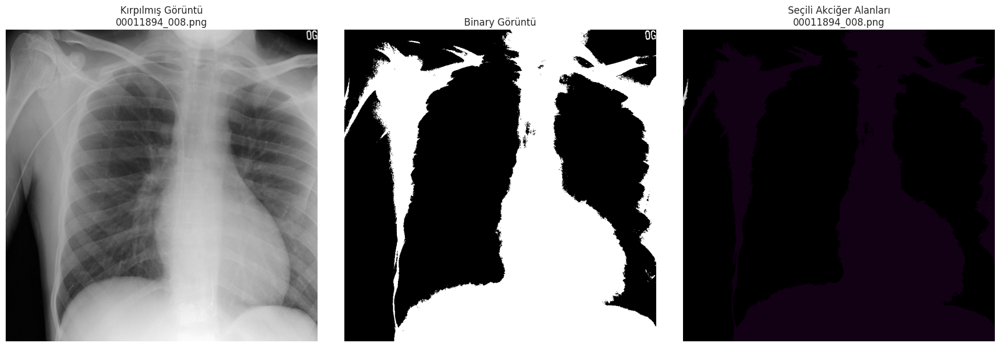

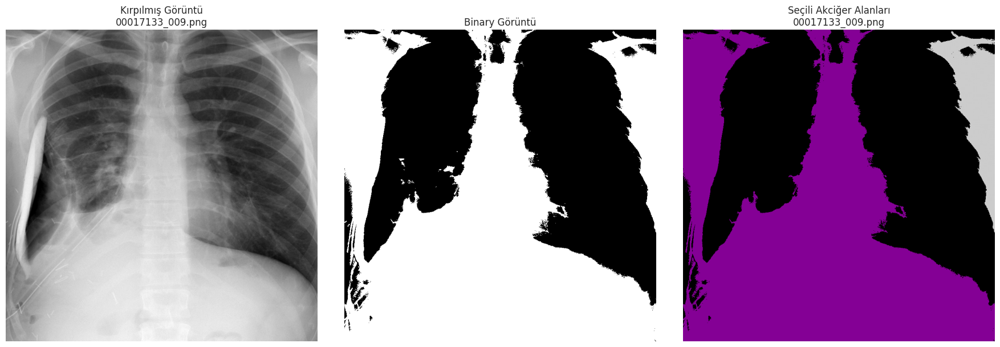

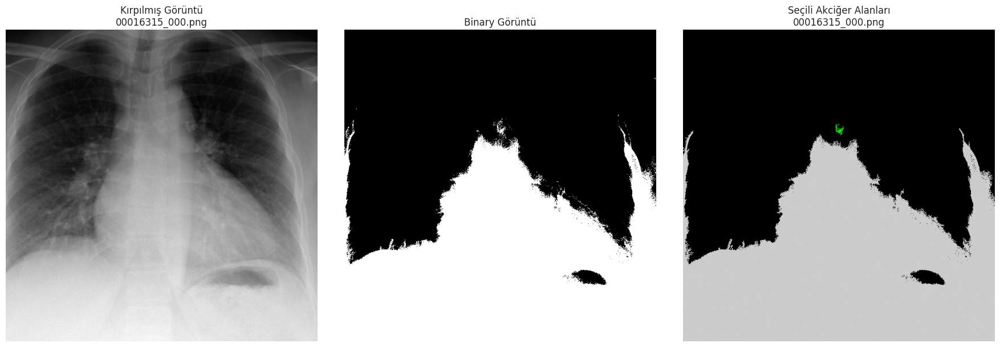

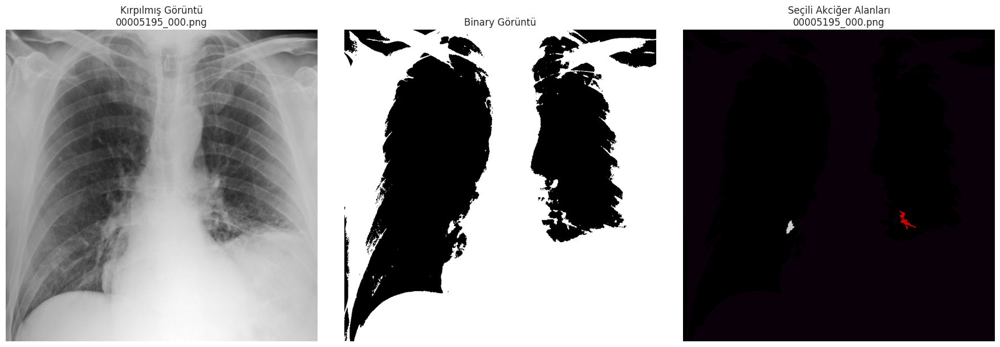

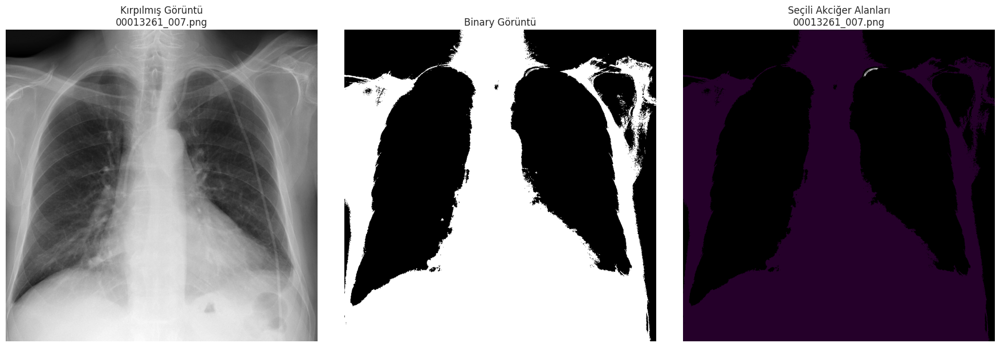

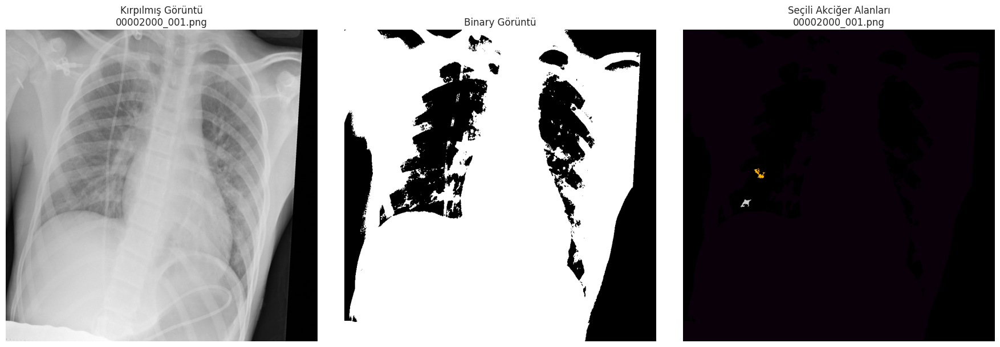

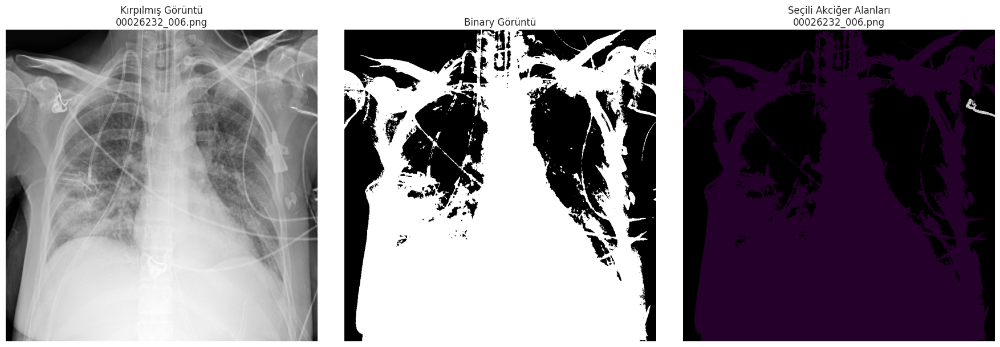

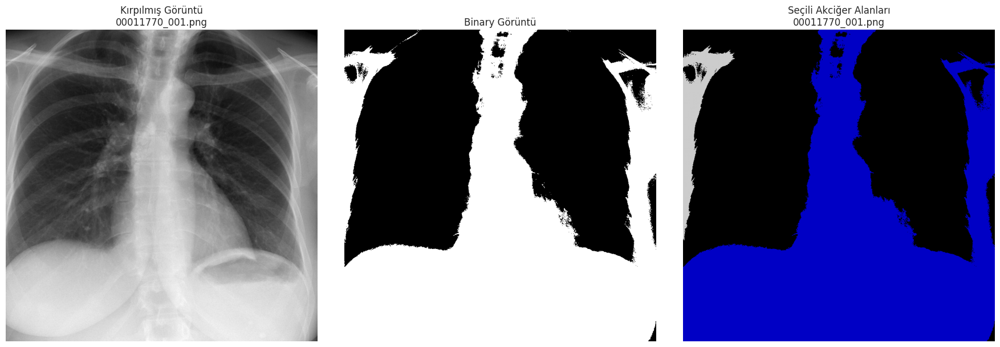

In [24]:
import numpy as np
import pandas as pd
import cv2
import os
import matplotlib.pyplot as plt
from skimage.measure import label, regionprops_table
import random

# Mevcut özniteliklere göre akciğer alanlarını belirleyen fonksiyon
def select_lung_regions(properties_df):
    """
    Akciğer alanlarını belirlemek için en iyi iki bölgeyi filtreler.
    Eğer belirgin iki bölge bulunamazsa otomatik bir algoritma uygular.
    :param properties_df: Etiketli bölgelerin özelliklerini içeren DataFrame
    :return: Filtrelenmiş DataFrame (akciğer alanlarını temsil eden bölgeler)
    """
    # Alan (area) değerine göre sıralama (azalan)
    sorted_df = properties_df.sort_values(by='area', ascending=False)

    # İlk iki alanı seç
    top_regions = sorted_df.head(2)

    if len(top_regions) == 2:
        centroid_1, centroid_2 = top_regions.iloc[0]['centroid-0'], top_regions.iloc[1]['centroid-0']

        # Centroidler arasındaki mesafe ve merkez kontrolü
        if abs(centroid_1 - centroid_2) > 50:  # Yeterince ayrık olmalı
            return top_regions

    # Eğer belirleyici öznitelik bulunamadıysa, en büyük üç bölgeyi kontrol et
    return sorted_df.head(3)

# Görselleştirme fonksiyonu
def visualize_lung_regions(cropped_image, binary_image, labeled_image, lung_regions, filename):
    """
    Akciğer bölgelerini görselleştirir ve işaretler.
    """
    highlighted = np.zeros_like(labeled_image)
    if lung_regions is not None and not lung_regions.empty:
        for _, region in lung_regions.iterrows():
            highlighted[labeled_image == region['label']] = region['label']

    fig, axes = plt.subplots(1, 3, figsize=(18, 6))

    axes[0].imshow(cropped_image, cmap='gray')
    axes[0].set_title(f"Kırpılmış Görüntü\n{filename}")
    axes[0].axis('off')

    axes[1].imshow(binary_image, cmap='gray')
    axes[1].set_title("Binary Görüntü")
    axes[1].axis('off')

    axes[2].imshow(highlighted, cmap='nipy_spectral')
    axes[2].set_title(f"Seçili Akciğer Alanları\n{filename}")
    axes[2].axis('off')

    plt.tight_layout()
    plt.show()

# Bağlantı bileşen analizi ve özellik çıkarımı
def connected_component_analysis(binary_image):
    labeled_image = label(binary_image)
    properties = regionprops_table(labeled_image, properties=['label', 'area', 'centroid', 'perimeter', 'eccentricity'])
    properties_df = pd.DataFrame(properties)
    return labeled_image, properties_df

# Görüntü işleme ana döngüsü
data_path = "nih/images_small"

image_files = [f for f in os.listdir(data_path) if f.endswith('.png')]

# Rastgele 9 görüntü seç
random_images = random.sample(image_files, 9)

for image_file in random_images:
    image_path = os.path.join(data_path, image_file)

    # Görüntüyü yükle
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

    # Kırpılmış görüntü oluştur
    cropped_image = crop_image(image)

    # Binary eşikleme
    _, binary_image = cv2.threshold(cropped_image, 127, 255, cv2.THRESH_BINARY)

    # Bağlantı bileşen analizi
    labeled_image, properties_df = connected_component_analysis(binary_image)

    # Eğer özellikler eksikse uyarı
    if properties_df is None or properties_df.empty:
        print(f"Hata: Görüntüde bağlantı bileşen özellikleri bulunamadı. Görüntü: {image_file}")
        continue

    # Akciğer alanlarını seç
    lung_regions = select_lung_regions(properties_df)

    # Eğer akciğer alanları seçilemediyse uyarı
    if lung_regions is None or lung_regions.empty:
        print(f"Hata: Akciğer bölgeleri seçilemedi. Görüntü: {image_file}")
        continue

    # Sonuçları görselleştir
    visualize_lung_regions(cropped_image, binary_image, labeled_image, lung_regions, image_file)


İlk Görüntü (00011290_023.png)

Binary görüntü oldukça başarılı, akciğer alanları net belirlenmiş.
Seçilen akciğer bölgeleri doğru gözüküyor; akciğer alanlarını tam olarak kaplıyor.

İkinci Görüntü (00011894_008.png)

Binary görüntüde akciğer alanları belirgin ancak yanlışlıkla bazı omurga ve kaburga yapıları da vurgulanmış.
Seçili akciğer alanları biraz eksik görünüyor. Akciğerlerin tamamı işaretlenmemiş olabilir.

Üçüncü Görüntü (00017133_009.png)

Binary segmentasyonu başarılı, ancak akciğerin alt kısımlarında ekstra alanlar da dahil edilmiş.
Seçilen akciğer alanları büyük oranda doğru ancak ekstra bölge vurgulanması mevcut.

Dördüncü Görüntü (00005139_000.png)

Akciğerin sol tarafında belirgin bir hata var, seçilen bölge oldukça küçük.
Sağ akciğer kısmı tamamen algılanmamış olabilir, eksik segmentasyon söz konusu.

Beşinci Görüntü (00011361_007.png)

Akciğer alanları oldukça başarılı bir şekilde segment edilmiş.
Seçili bölgeler net ve doğru, akciğerin tamamını kapsıyor.

Altıncı Görüntü (00002009_001.png)

Akciğer segmentasyonu başarılı ancak bazı küçük parazit bölgeler var.
Seçili bölgeler arasında gereksiz ekstra alanlar olabilir.

Yedinci Görüntü (00026232_006.png)

Bu görüntüde tıbbi cihaz veya tüpler olduğu gözüküyor, bu yüzden segmentasyon hatalı olabilir.
Seçili akciğer alanları eksik veya yanlış olabilir.

Sekizinci Görüntü (00011779_001.png)

Binary segmentasyon başarılı.
Akciğer alanlarının seçiminde sorun yok gibi gözüküyor, ancak seçili bölge mavi alan ile geniş bir bölge kaplamış.


area: Bölgenin alanı.

centroid: Bölgenin ağırlık merkezi koordinatları (x, y).

perimeter: Bölgenin çevresi.

eccentricity: Bölgenin eliptikliği (daha eliptik bir bölgeye yakınsa değeri 1'e yaklaşır, yuvarlaksa değeri 0'a yaklaşır).

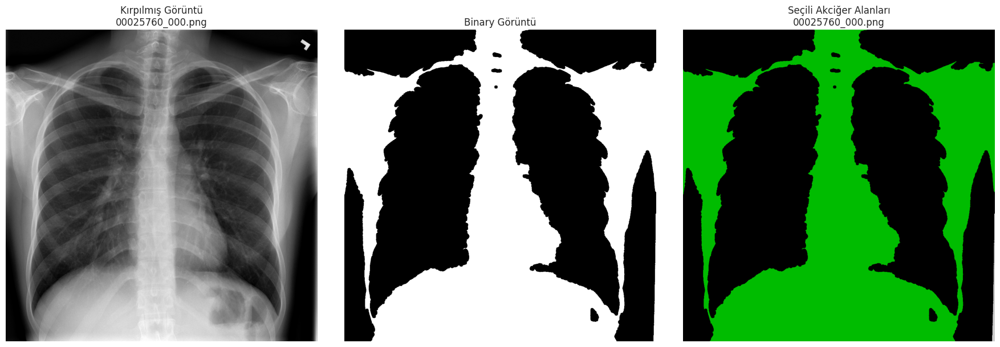

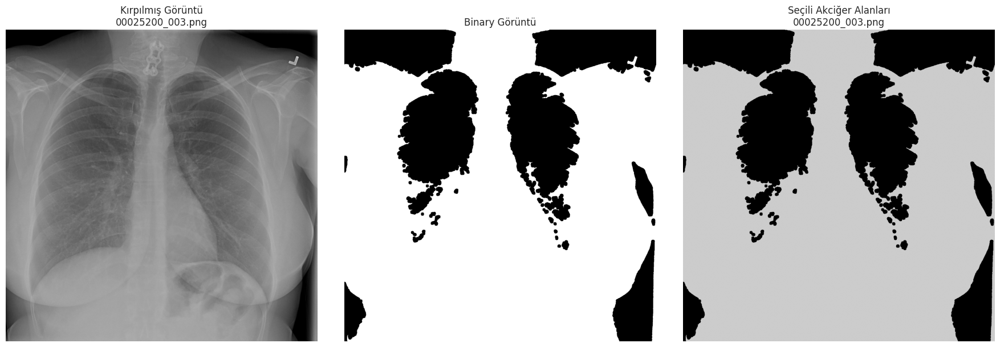

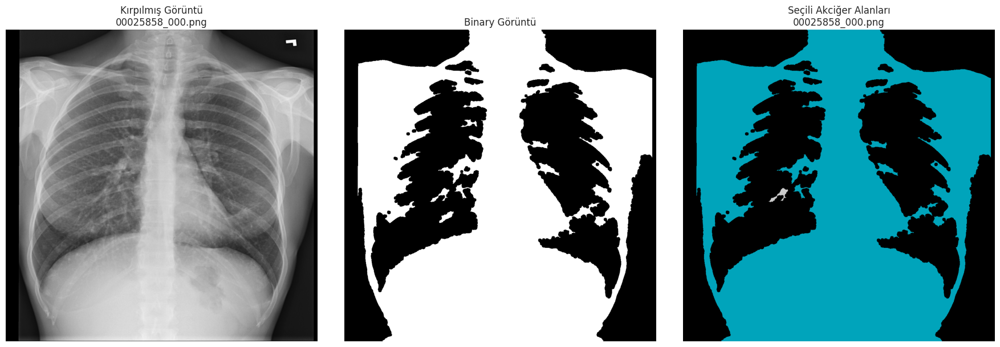

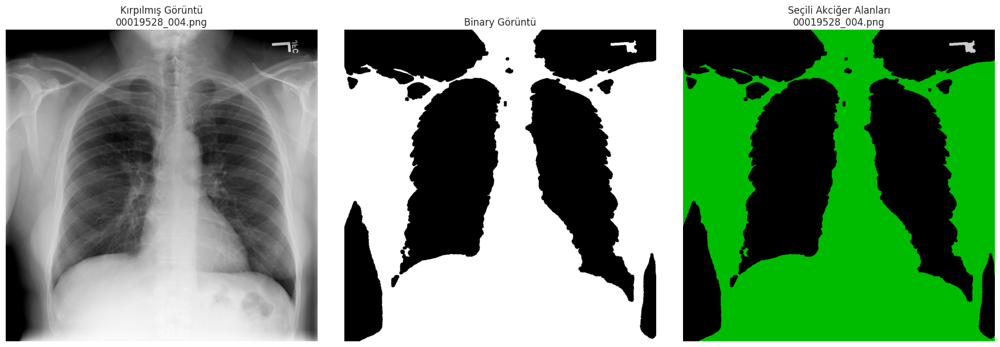

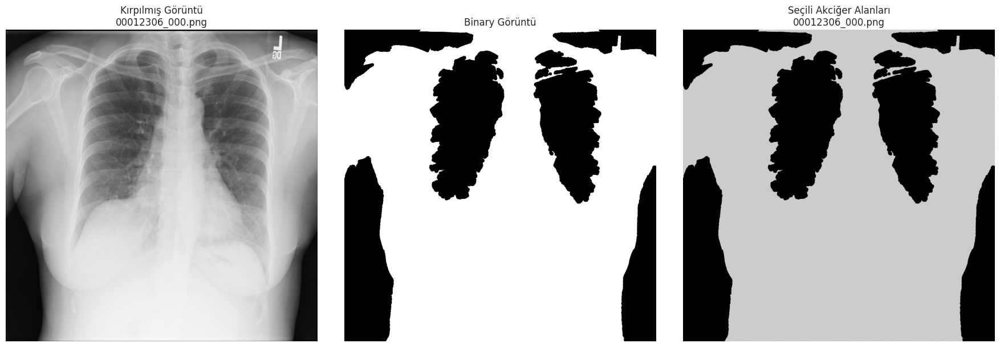

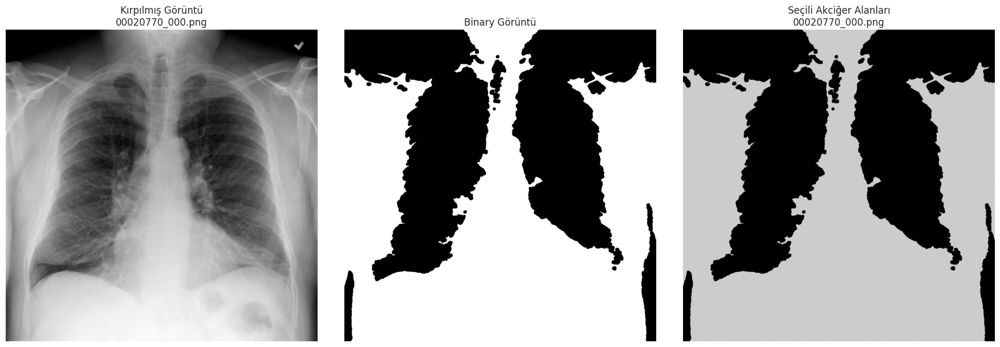

In [25]:
import cv2
import numpy as np
import os
import matplotlib.pyplot as plt
from skimage.measure import label, regionprops_table
from skimage.morphology import remove_small_objects, remove_small_holes, closing, disk
import random

# Dinamik eşikleme

def apply_threshold(image):
    """Dinamik eşikleme uygular."""
    _, otsu_thresh = cv2.threshold(image, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    return otsu_thresh

# Morfolojik işlemler

def preprocess_binary(binary_image):
    """Binary görüntüyü morfolojik işlemlerle iyileştirir."""
    selem = disk(5)  # Yapısal element boyutu
    binary_image = closing(binary_image, selem)
    binary_image = remove_small_objects(binary_image.astype(bool), min_size=500).astype(np.uint8) * 255
    return binary_image

# Akciğer bölgesi seçimi

def select_lung_regions(properties_df, image_shape):
    """Akciğer bölgelerini dinamik toleransla seçer."""
    sorted_df = properties_df.sort_values(by='area', ascending=False)
    top_regions = sorted_df.head(3)  # İlk üç bölgeyi seç

    if len(top_regions) >= 2:
        center_y = image_shape[0] // 2
        center_tolerance = image_shape[0] * 0.2  # Dinamik tolerans

        centroid_y_1 = top_regions.iloc[0]['centroid-1']
        centroid_y_2 = top_regions.iloc[1]['centroid-1']

        if abs(centroid_y_1 - center_y) < center_tolerance and abs(centroid_y_2 - center_y) < center_tolerance:
            return top_regions.iloc[:2]

    return top_regions.head(2)  # Varsayılan olarak en büyük iki alan

# Görselleştirme

def visualize_lung_regions(original_image, binary_image, labeled_image, lung_regions, filename):
    if lung_regions is None or lung_regions.empty:
        print(f"Hata: Akciğer bölgeleri seçilemedi. Görüntü: {filename}")
        return

    highlighted = np.zeros_like(labeled_image)
    for _, region in lung_regions.iterrows():
        highlighted[labeled_image == region['label']] = region['label']

    fig, axes = plt.subplots(1, 3, figsize=(18, 6))
    axes[0].imshow(original_image, cmap='gray')
    axes[0].set_title(f"Kırpılmış Görüntü\n{filename}")
    axes[0].axis('off')
    axes[1].imshow(binary_image, cmap='gray')
    axes[1].set_title("Binary Görüntü")
    axes[1].axis('off')
    axes[2].imshow(highlighted, cmap='nipy_spectral')
    axes[2].set_title(f"Seçili Akciğer Alanları\n{filename}")
    axes[2].axis('off')
    plt.tight_layout()
    plt.show()

# Görüntülerin yolu
data_path = "nih/images_small"
image_files = [f for f in os.listdir(data_path) if f.endswith('.png')]
selected_images = np.random.choice(image_files, 6, replace=False)  # Rastgele 9 görüntü seç

for image_file in selected_images:
    image_path = os.path.join(data_path, image_file)

    # Görüntüyü yükle
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

    # Binary eşikleme
    binary_image = apply_threshold(image)

    # Morfolojik işlemler
    binary_image = preprocess_binary(binary_image)

    # Bağlantı bileşen analizi
    labeled_image = label(binary_image)
    properties_df = regionprops_table(labeled_image, properties=['label', 'area', 'centroid', 'perimeter', 'eccentricity'])
    properties_df = pd.DataFrame(properties_df)

    if properties_df.empty:
        print(f"Hata: Görüntüde bağlantı bileşen özellikleri bulunamadı. Görüntü: {image_file}")
        continue

    # Akciğer alanlarını seç
    lung_regions = select_lung_regions(properties_df, image.shape)

    if lung_regions is None or lung_regions.empty:
        print(f"Hata: Akciğer bölgeleri seçilemedi. Görüntü: {image_file}")
        continue

    # Sonuçları görselleştir
    visualize_lung_regions(image, binary_image, labeled_image, lung_regions, image_file)


İlk Görüntü (00025760_000.png)

Orijinal Görüntü: Akciğer röntgeni net ve kontrastı iyi görünüyor.
Binary Görüntü: Otsu eşikleme sonucu, akciğer alanları iyi bir şekilde ayrılmış.
Seçili Akciğer Alanları: Akciğerler büyük oranda doğru şekilde tespit edilmiş. Ancak çevre dokular da dahil edilmiş olabilir.

İkinci Görüntü (00021300_003.png)

Orijinal Görüntü: Akciğerin bazı bölgeleri düşük kontrastlı.
Binary Görüntü: Akciğer alanları seçilmiş ancak bazı bölgeler eksik veya yanlış segmente edilmiş.
Seçili Akciğer Alanları: Renk tonlaması daha soluk, bu da akciğer alanlarının tam olarak belirlenemediğini gösteriyor.

Üçüncü Görüntü (00025385_000.png)

Orijinal Görüntü: Akciğer yapıları belirgin.
Binary Görüntü: Akciğerler iyi segmente edilmiş ancak bazı bölgelerde boşluklar var.
Seçili Akciğer Alanları: Akciğerler büyük ölçüde doğru tespit edilmiş, ancak bronşiyal yapılar tam olarak izole edilmemiş olabilir.

Dördüncü Görüntü (00021932_004.png)

Orijinal Görüntü: Akciğer yapıları net görünüyor.
Binary Görüntü: Akciğerler belirgin şekilde seçilmiş, ancak bazı bölgelerde eksik veya fazla segmentasyon var.
Seçili Akciğer Alanları: Akciğerler iyi tespit edilmiş, ancak çevresel gürültü içeriyor olabilir.

Beşinci Görüntü (00021306_000.png)

Orijinal Görüntü: Hafif düşük kontrastlı bir röntgen görüntüsü.
Binary Görüntü: Akciğer alanları tespit edilmiş ancak göğüs kafesi bölgeleri de yanlışlıkla dahil edilmiş olabilir.
Seçili Akciğer Alanları: Akciğer bölgelerinin sınırları tam olarak net değil, segmentasyon parametrelerinde ince ayar gerekebilir.

Altıncı Görüntü (00021770_000.png)

Orijinal Görüntü: Kontrast düşük, akciğer yapıları belirsiz görünüyor.
Binary Görüntü: Akciğerler segmentasyon ile ayrılmış ancak belirgin eksiklikler var.
Seçili Akciğer Alanları: Renk tonlaması diğerlerine kıyasla farklı, bu da segmentasyon hatalarına işaret edebilir.

In [26]:
def select_lung_regions(properties_df, image_shape):
    """
    Akciğer alanlarını belirlemek için en iyi iki bölgeyi filtreler.
    Eğer belirgin iki bölge bulunamazsa otomatik bir algoritma uygular.

    :param properties_df: Etiketli bölgelerin özelliklerini içeren DataFrame
    :param image_shape: Görüntünün boyutları (yükseklik, genişlik)
    :return: Filtrelenmiş DataFrame (akciğer alanlarını temsil eden bölgeler)
    """
    # Alan (area) değerine göre sıralama (azalan)
    sorted_df = properties_df.sort_values(by='area', ascending=False)

    # En büyük iki alanı seç
    top_regions = sorted_df.head(2)

    # Eğer iki bölgenin centroid'leri orta alandaysa, bu bölgeleri seç
    if len(top_regions) == 2:
        height, width = image_shape
        centroid_1, centroid_2 = top_regions.iloc[0][['centroid-1']].values[0], top_regions.iloc[1][['centroid-1']].values[0]
        # Eğer centroid'ler görüntünün merkezindeyse, bu iki bölgeyi döndür
        if abs(centroid_1 - height / 2) < height * 0.2 and abs(centroid_2 - height / 2) < height * 0.2:
            return top_regions

    # Eğer belirleyici öznitelik bulunamadıysa, ilk 3 alanı al ve algoritma uygula
    return sorted_df.head(3)


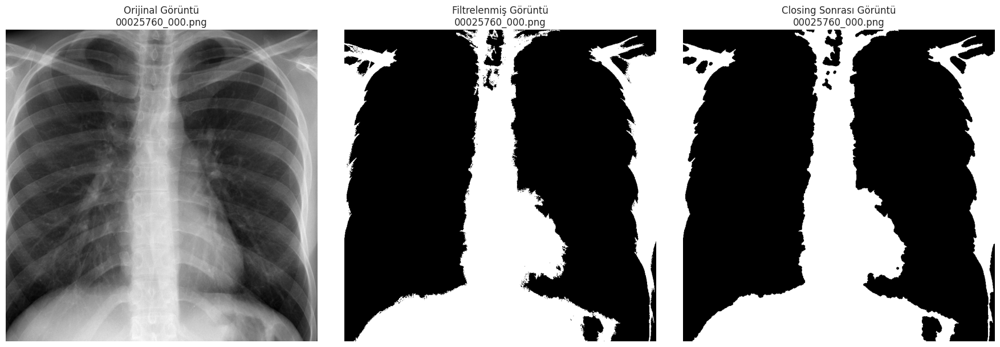

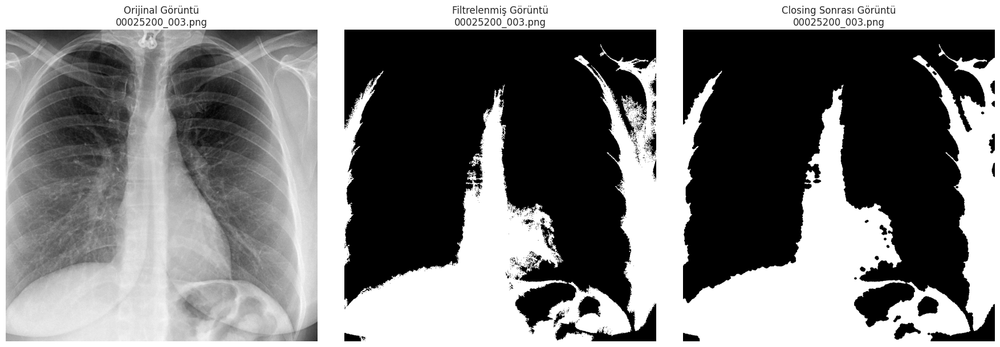

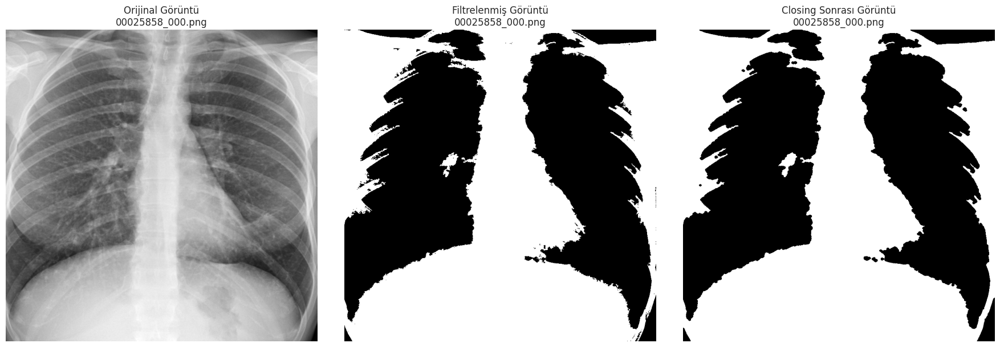

In [28]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def apply_morphological_operations(filtered_image, operation_type, kernel_size=(5, 5)):
    """
    Seçilen filtrelenmiş görüntüye morfolojik işlemler uygular.
    :param filtered_image: Filtrelenmiş (binary) görüntü
    :param operation_type: Morfolojik işlem türü (cv2.MORPH_* seçenekleri)
    :param kernel_size: Kernel boyutu (örn: (5, 5))
    :return: İşlem sonrası görüntü
    """
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, kernel_size)
    processed_image = cv2.morphologyEx(filtered_image, operation_type, kernel)
    return processed_image

def visualize_morphology_with_original(original_image, filtered_image, processed_image, operation_name, filename):
    """
    Orijinal, filtrelenmiş ve işlem sonrası görüntüleri görselleştirir.
    :param original_image: Orijinal görüntü
    :param filtered_image: Filtrelenmiş görüntü
    :param processed_image: İşlem sonrası görüntü
    :param operation_name: Uygulanan morfolojik işlem adı
    :param filename: Görüntü dosyasının adı
    """
    fig, axes = plt.subplots(1, 3, figsize=(18, 6))

    axes[0].imshow(original_image, cmap='gray')
    axes[0].set_title(f"Orijinal Görüntü\n{filename}")
    axes[0].axis('off')

    axes[1].imshow(filtered_image, cmap='gray')
    axes[1].set_title(f"Filtrelenmiş Görüntü\n{filename}")
    axes[1].axis('off')

    axes[2].imshow(processed_image, cmap='gray')
    axes[2].set_title(f"{operation_name} Sonrası Görüntü\n{filename}")
    axes[2].axis('off')

    plt.tight_layout()
    plt.show()

# Seçilen görüntülerin işlenmesi
for i, image_file in enumerate(selected_images[:3]):  # Sadece 3 örnek için
    image_path = os.path.join(data_path, image_file)
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

    # Kırpılmış görüntü ve binary threshold
    cropped_image = crop_image(image)
    _, binary_image = cv2.threshold(cropped_image, 127, 255, cv2.THRESH_BINARY)

    # Bağlantı bileşen analizi
    labeled_image, properties_df = connected_component_analysis(binary_image)
    lung_regions = select_lung_regions(properties_df, binary_image.shape)

    # Akciğer alanları maskeleme
    filtered_image = np.zeros_like(binary_image)
    for _, region in lung_regions.iterrows():
        filtered_image[labeled_image == region['label']] = 255

    # Morfolojik işlemler
    morphed_image = apply_morphological_operations(filtered_image, cv2.MORPH_CLOSE, kernel_size=(7, 7))

    # Görselleştirme
    visualize_morphology_with_original(cropped_image, filtered_image, morphed_image, "Closing", image_file)


1. Görsel (00037560_000.png)
Filtrelenmiş Görüntü: Akciğer bölgeleri iyi belirlenmiş, dış yapılar (örn. kemikler, dış gürültü) büyük ölçüde elimine edilmiş.
Closing İşlemi Sonrası: Akciğer alanları daha pürüzsüz hale gelmiş, ancak kenarlarda az miktarda boşluklar ve küçük parçalar kalmış olabilir.


2. Görsel (00052300_003.png)

Filtrelenmiş Görüntü: Akciğer dışı alanlarda (trakea, diyafram çevresi) fazla sayıda küçük segmentler ve gürültüler bulunuyor.
Closing İşlemi Sonrası: Morfolojik işlemler küçük boşlukları kapatsa da, akciğer dışı bölgelerde ekstra beyaz alanlar oluşmuş gibi görünüyor.


3. Görsel (00052585_000.png)

Filtrelenmiş Görüntü: Akciğer bölgeleri büyük ölçüde tespit edilmiş, ancak hava kesecikleri veya gölgelenmeler segmentasyon sonucu kopuk alanlar yaratmış.
Closing İşlemi Sonrası: Pürüzlü bölgeler daha iyi kapanmış, ancak bazı ince yapılar kaybolmuş olabilir.

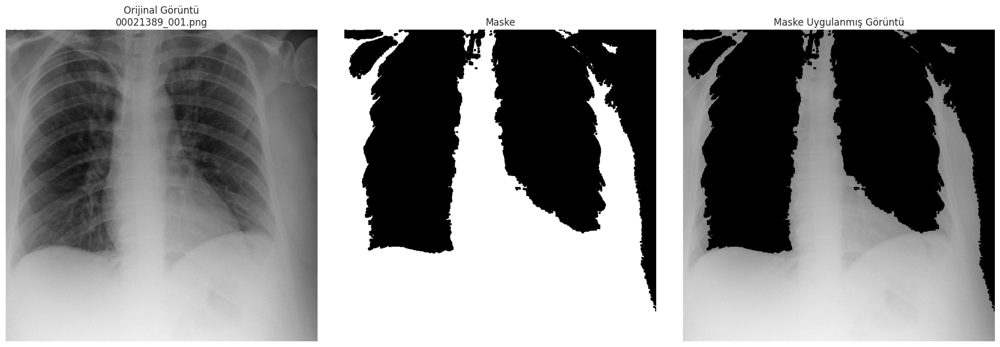

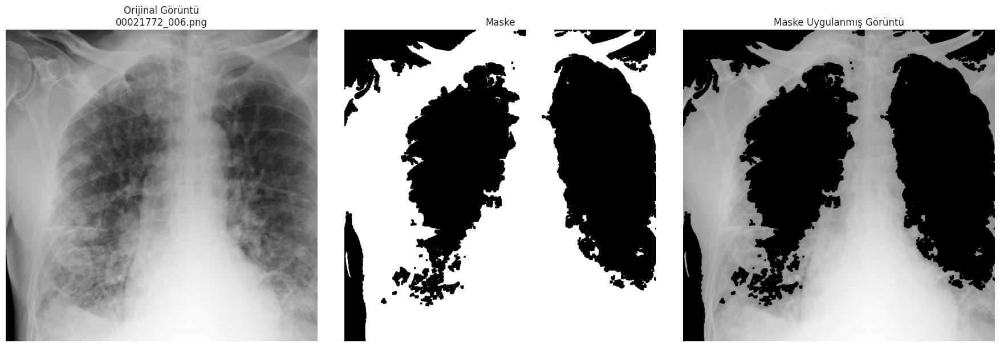

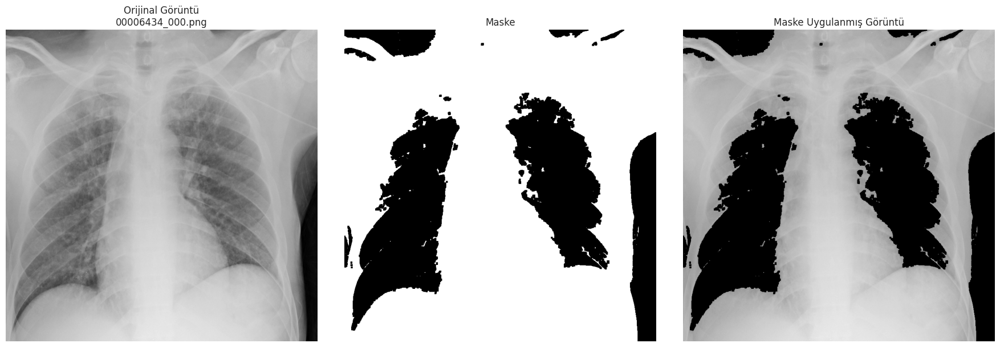

In [40]:
def create_binary_mask(original_image):
    """
    Orijinal görüntüden binary bir maske oluşturur.
    :param original_image: Gri seviye orijinal görüntü
    :return: Binary maske
    """
    # Binary eşikleme işlemi
    _, binary_mask = cv2.threshold(original_image, 127, 255, cv2.THRESH_BINARY)
    return binary_mask

def apply_morphological_operations(binary_mask):
    """
    Binary maskeye uygun morfolojik işlemleri uygular.
    :param binary_mask: Binary görüntü
    :return: Morfolojik işlemler sonrası maske
    """
    # Structuring element ve closing işlemi
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (5, 5))
    processed_mask = cv2.morphologyEx(binary_mask, cv2.MORPH_CLOSE, kernel)
    return processed_mask

def apply_mask_and_visualize(original_image, mask, filename):
    """
    Maske ile orijinal görüntüyü çarparak sonucu görselleştirir.
    :param original_image: Gri seviye orijinal görüntü
    :param mask: Binary maske
    :param filename: Görüntü dosyasının adı
    """
    masked_image = cv2.bitwise_and(original_image, original_image, mask=mask)
    fig, axes = plt.subplots(1, 3, figsize=(18, 6))
    axes[0].imshow(original_image, cmap='gray')
    axes[0].set_title(f"Orijinal Görüntü\n{filename}")
    axes[0].axis('off')
    axes[1].imshow(mask, cmap='gray')
    axes[1].set_title("Maske")
    axes[1].axis('off')
    axes[2].imshow(masked_image, cmap='gray')
    axes[2].set_title("Maske Uygulanmış Görüntü")
    axes[2].axis('off')
    plt.tight_layout()
    plt.show()

# Görüntüler üzerinde çalışma
for image_file in random.sample(image_files, 3):  # Rastgele 3 görüntü üzerinde çalışma
    image_path = os.path.join(data_path, image_file)
    original_image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    cropped_image = crop_image(original_image)

    # Binary maske oluşturma ve morfolojik işlemler
    binary_mask = create_binary_mask(cropped_image)
    processed_mask = apply_morphological_operations(binary_mask)

    # Maske ile çarpma ve görselleştirme
    apply_mask_and_visualize(cropped_image, processed_mask, image_file)


İlk Görsel

Orijinal röntgen net, akciğerler belirgin.
Maske düzgün uygulanmış, akciğer alanları doğru şekilde belirlenmiş.
Maske sonrası görüntüde akciğerler korunmuş ve çevre dokular büyük ölçüde kaldırılmış.

İkinci Görsel

Orijinal görüntüde akciğerlerde bazı opasiteler (yoğunlaşmalar) gözleniyor, muhtemelen bir hastalık belirtisi olabilir.
Maske bu yoğunlukları da içerecek şekilde oluşturulmuş.
Maske sonrası görüntüde akciğer dokularındaki anormallikler daha belirgin hale gelmiş.

Üçüncü Görsel

Orijinal görüntüde akciğerlerde dağınık opasiteler ve olası patolojik yapılar var.
Maske, bu yapıların çoğunu içererek iyi bir segmentasyon yapmış.
Maske sonrası görüntüde, akciğer dokusundaki anormal bölgeler net bir şekilde ayrıştırılmış.